<a href="https://colab.research.google.com/github/skytecat/tbank-logo-detector/blob/main/tbank_logo_detector.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Первичный отбор изображений с найденными логотипами

## Автоматическая разметка с достаточно высокой степенью уверенности

In [ ]:
import cv2
import os
import numpy as np
import shutil
from pathlib import Path

# ========================
# НАСТРОЙКИ
# ========================

# Папка с частями (part_1, part_2, ...)
PARTS_BASE_DIR = "/content/drive/MyDrive/SIRIUS/data_for_sirius_parts"

# Папка с шаблонами
TEMPLATE_DIR = "/content/drive/MyDrive/SIRIUS/templates_2"

# Папка для отобранных изображений (для ручной разметки)
OUTPUT_DIR = "/content/drive/MyDrive/SIRIUS/images_for_manual_labeling_2"

MATCH_THRESHOLD = 0.75


# ========================
#  ПОДГОТОВКА ПАПОК
# ========================

Path(OUTPUT_DIR).mkdir(parents=True, exist_ok=True)

# ========================
# ЗАГРУЗКА ШАБЛОНОВ
# ========================

templates = []
template_names = []

if not os.path.exists(TEMPLATE_DIR):
    raise Exception(f"❗ Папка с шаблонами не найдена: {TEMPLATE_DIR}")

for fname in os.listdir(TEMPLATE_DIR):
    if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
        path = os.path.join(TEMPLATE_DIR, fname)
        template = cv2.imread(path, 0)  # градации серого
        if template is not None:
            templates.append(template)
            template_names.append(fname)
            print(f"✅ Загружен шаблон: {fname} | Размер: {template.shape}")
        else:
            print(f"❌ Не удалось загрузить шаблон: {fname}")

if len(templates) == 0:
    raise Exception("❗ Не найдено ни одного шаблона в папке templates/")

# ========================
# ПРОХОД ПО ВСЕМ PART_X ПАПКАМ
# ========================

# Находим все папки вида part_1, part_2, ...
part_dirs = sorted(
    [d for d in Path(PARTS_BASE_DIR).iterdir() if d.is_dir() and d.name.startswith("part_")],
    key=lambda x: int(x.name.split("_")[-1])  # сортируем по номеру: part_1, part_2, ...
)

if not part_dirs:
    raise Exception(f"❗ Не найдено папок part_* в {PARTS_BASE_DIR}")

print(f"📂 Найдено {len(part_dirs)} папок: {[d.name for d in part_dirs]}")

selected_count = 0

for part_dir in part_dirs[:10]:
    print(f"\n--- 📁 Обработка папки: {part_dir.name} ---")

    # Получаем список изображений в папке
    image_files = [
        f for f in os.listdir(part_dir)
        if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.webp'))
    ]

    print(f"🖼️  Изображений в папке: {len(image_files)}")

    for img_file in image_files:

        img_path = part_dir / img_file
        img = cv2.imread(str(img_path))
        if img is None:
            print(f"⚠️  Не удалось загрузить: {img_file}")
            continue
        if not has_yellow_color(img):
            continue

        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        img_h, img_w = img_gray.shape

        found_match = False

        # Пробуем каждый шаблон
        for template in templates:
            h, w = template.shape

            # Если шаблон больше — уменьшаем его пропорционально
            if h > img_h or w > img_w:
                # Вычисляем масштаб: чтобы шаблон влез по большей стороне
                scale = min(img_h / h, img_w / w) * 0.9  # 0.9 — небольшой запас

                new_h = int(h * scale)
                new_w = int(w * scale)

                template = cv2.resize(template, (new_w, new_h))
                h, w = template.shape  # обновляем размеры

            # Совпадение шаблона
            res = cv2.matchTemplate(img_gray, template, cv2.TM_CCOEFF_NORMED)
            loc = np.where(res >= MATCH_THRESHOLD)

            if len(loc[0]) > 0:  # хотя бы одно совпадение
                found_match = True
                break

        # Если совпадение найдено — копируем
        if found_match:
            dest_path = Path(OUTPUT_DIR) / img_file
            shutil.copy(img_path, dest_path)
            selected_count += 1
            print(f"[{selected_count}] ✅ Отобрано: {img_file}")

# ========================
# ИТОГ
# ========================

print(f"\n🎉 Готово!")
print(f"✅ Всего отобрано изображений: {selected_count}")
print(f"📁 Сохранены в: {OUTPUT_DIR}")

✅ Загружен шаблон: T_bank_1.jpg | Размер: (177, 192)
✅ Загружен шаблон: T_bank_2.jpeg | Размер: (74, 77)
✅ Загружен шаблон: T_bank_8.png | Размер: (67, 60)
✅ Загружен шаблон: T_bank_8.jpg | Размер: (293, 291)
✅ Загружен шаблон: T_bank_9.jpg | Размер: (295, 291)
✅ Загружен шаблон: T_bank_10.jpg | Размер: (307, 295)
📂 Найдено 15 папок: ['part_001', 'part_002', 'part_003', 'part_004', 'part_005', 'part_006', 'part_007', 'part_008', 'part_009', 'part_010', 'part_011', 'part_012', 'part_013', 'part_014', 'part_015']

--- 📁 Обработка папки: part_001 ---
🖼️  Изображений в папке: 200
[1] ✅ Отобрано: 00231640870e84c921bf550bb807279c.jpg
[2] ✅ Отобрано: 008d058c1e4b88607d8fa445ee127531.jpg
[3] ✅ Отобрано: 0109cd854b2549c07e3591bd74a5e5c2.jpg
[4] ✅ Отобрано: 018132ccfe3c25f02380caab34a8e84f.jpg
[5] ✅ Отобрано: 019b9876a3c5b5f66e58376f6c3a5b29.jpg
[6] ✅ Отобрано: 01aa8f7b301bede05c35c2607b303050.jpg

--- 📁 Обработка папки: part_002 ---
🖼️  Изображений в папке: 200
[7] ✅ Отобрано: 02774d079c5994791

## Проверка и сохранение правильно размеченных изображений

In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from IPython.display import display, clear_output
import ipywidgets as widgets

# ========================
#  НАСТРОЙКИ
# ========================

IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/images_for_manual_labeling_2"
TEMPLATE_DIR = "/content/drive/MyDrive/SIRIUS/templates_2"
LABEL_DIR = "/content/drive/MyDrive/SIRIUS/auto_labels_2"

MATCH_THRESHOLD = 0.75
START_INDEX = 0
CLASS_ID = 0

editor_used = False

Path(LABEL_DIR).mkdir(parents=True, exist_ok=True)

# ========================
#  ФУНКЦИЯ ПРОВЕРКИ ЖЕЛТОГО ЦВЕТА
# ========================

def has_yellow_color(img, threshold_ratio=0.1):
    if img is None or img.size == 0:
        return False
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lower_yellow = np.array([20, 100, 100])
    upper_yellow = np.array([35, 255, 255])
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    yellow_ratio = cv2.countNonZero(mask) / mask.size
    return yellow_ratio >= threshold_ratio

# ========================
#  ЗАГРУЗКА ШАБЛОНОВ
# ========================

templates = []
template_names = []

for fname in os.listdir(TEMPLATE_DIR):
    if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
        path = os.path.join(TEMPLATE_DIR, fname)
        template = cv2.imread(path, 0)
        if template is not None:
            templates.append(template)
            template_names.append(fname)
            print(f"✅ Загружен шаблон: {fname}")
        else:
            print(f"❌ Не удалось загрузить шаблон: {fname}")

if len(templates) == 0:
    raise Exception("❗ Нет шаблонов для поиска")

# ========================
#  ПОЛУЧАЕМ СПИСОК ИЗОБРАЖЕНИЙ
# ========================

image_files = sorted([
    f for f in os.listdir(IMAGE_DIR)
    if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.webp'))
])

print(f"📁 Всего изображений: {len(image_files)}")
if START_INDEX >= len(image_files):
    raise IndexError(f"START_INDEX={START_INDEX} больше количества файлов ({len(image_files)})")

# ========================
#  ГЛОБАЛЬНЫЕ ПЕРЕМЕННЫЕ
# ========================

current_index = START_INDEX
current_bboxes = []  # автоматически найденные рамки
manual_bboxes = []   # отредактированные/добавленные вручную
current_img_file = None
img_shape = (0, 0)

# ========================
#  ФУНКЦИЯ СОХРАНЕНИЯ РАЗМЕТКИ
# ========================

def save_labels():
    global current_img_file, manual_bboxes, editor_used
    if not manual_bboxes or not current_img_file:
        print("⚠️  Нет данных для сохранения.")
        return

    label_file = Path(current_img_file).stem + ".txt"
    label_path = os.path.join(LABEL_DIR, label_file)

    img_path = os.path.join(IMAGE_DIR, current_img_file)
    img = cv2.imread(img_path)
    h_img, w_img = img.shape[:2]

    with open(label_path, 'w') as f:
        if not editor_used:
            # Сохраняем только лучшую рамку
            x1, y1, x2, y2 = manual_bboxes[0]
            x_center = ((x1 + x2) / 2) / w_img
            y_center = ((y1 + y2) / 2) / h_img
            width = abs(x2 - x1) / w_img
            height = abs(y2 - y1) / h_img
            f.write(f"{CLASS_ID} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")
            print(f"✅ Сохранена разметка: {label_file} | Объектов: 1 (автоматическая)")
        else:
            # Сохраняем все рамки
            for (x1, y1, x2, y2) in manual_bboxes:
                x_center = ((x1 + x2) / 2) / w_img
                y_center = ((y1 + y2) / 2) / h_img
                width = abs(x2 - x1) / w_img
                height = abs(y2 - y1) / h_img
                f.write(f"{CLASS_ID} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")
            print(f"✅ Сохранена разметка: {label_file} | Объектов: {len(manual_bboxes)} (ручная)")

# ========================
# ФУНКЦИЯ ОТОБРАЖЕНИЯ + КНОПОК
# ========================

def show_current_image():
    global current_index, current_bboxes, manual_bboxes, current_img_file, img_shape
    global editor_used

    # Сбрасываем флаг при переходе к новому изображению
    editor_used = False

    if current_index >= len(image_files):
        print("🎉 Обработка завершена!")
        return

    img_file = image_files[current_index]
    img_path = os.path.join(IMAGE_DIR, img_file)
    img = cv2.imread(img_path)
    if img is None:
        print(f"⚠️  {img_file} — не удалось загрузить")
        current_index += 1
        show_current_image()
        return

    if not has_yellow_color(img, threshold_ratio=0.1):
        current_index += 1
        show_current_image()
        return

    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_display = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()
    found = False
    bboxes = []

    for template in templates:
        h, w = template.shape
        if h > img_gray.shape[0] or w > img_gray.shape[1]:
            continue

        res = cv2.matchTemplate(img_gray, template, cv2.TM_CCOEFF_NORMED)
        loc = np.where(res >= MATCH_THRESHOLD)

        if len(loc[0]) > 0:
            found = True
            if not editor_used:
                # Находим индекс максимального значения уверенности
                max_val = res.max()
                max_loc = np.unravel_index(res.argmax(), res.shape)
                y1, x1 = max_loc  # в res индексы [y, x]
                x2, y2 = x1 + w, y1 + h

                # Добавляем только одну рамку с максимальной уверенностью
                bboxes.append((x1, y1, x2, y2))
                cv2.rectangle(img_display, (x1, y1), (x2, y2), (255, 0, 0), 3)
            else:
                for pt in zip(*loc[::-1]):
                    x1, y1 = pt
                    x2, y2 = x1 + w, y1 + h
                    bboxes.append((x1, y1, x2, y2))
                    cv2.rectangle(img_display, (x1, y1), (x2, y2), (255, 0, 0), 3)

            break  # выходим из цикла по шаблонам

    if not found:
        current_index += 1
        show_current_image()
        return

    # Сохраняем текущее состояние
    current_bboxes = bboxes
    manual_bboxes.clear()
    manual_bboxes.extend(bboxes)
    current_img_file = img_file
    img_shape = img.shape[:2]

    # Отображаем изображение
    plt.figure(figsize=(12, 8))
    plt.imshow(img_display)
    plt.title(f"[{current_index}] {img_file}")
    plt.axis('off')
    plt.show()

    # Кнопки
    btn_edit = widgets.Button(description="✏️ Редактировать рамки", button_style='primary')
    btn_accept = widgets.Button(description="✅ Принять как есть", button_style='success')
    btn_skip = widgets.Button(description="⏭ Пропустить", button_style='warning')
    btn_box = widgets.HBox([btn_edit, btn_accept, btn_skip])

    def on_edit(b):
        edit_bboxes_ui(on_accept)

    def on_accept(b):
        save_labels()
        advance()

    def on_skip(b):
        advance()

    def advance():
        global current_index
        current_index += 1
        clear_output(wait=True)
        show_current_image()

    btn_edit.on_click(on_edit)
    btn_accept.on_click(on_accept)
    btn_skip.on_click(on_skip)

    display(btn_box)

# ========================
# ✏️ ФУНКЦИЯ РЕДАКТИРОВАНИЯ РАМОК
# ========================

def edit_bboxes_ui(on_accept_callback):
    global editor_used
    editor_used = True  # Пользователь зашёл в редактор

    global manual_bboxes, img_shape, current_img_file

    if not manual_bboxes:
        print("⚠️  Нет рамок для редактирования.")
        return

    # Слайдеры (максимумы под размер изображения)
    h, w = img_shape
    x1_slider = widgets.IntSlider(description='x1 (лево)', min=0, max=w, value=int(manual_bboxes[0][0]) if manual_bboxes else 0, continuous_update=False)
    y1_slider = widgets.IntSlider(description='y1 (верх)', min=0, max=h, value=int(manual_bboxes[0][1]) if manual_bboxes else 0, continuous_update=False)
    x2_slider = widgets.IntSlider(description='x2 (право)', min=0, max=w, value=int(manual_bboxes[0][2]) if manual_bboxes else 50, continuous_update=False)
    y2_slider = widgets.IntSlider(description='y2 (низ)', min=0, max=h, value=int(manual_bboxes[0][3]) if manual_bboxes else 50, continuous_update=False)

    # Кнопки
    btn_add = widgets.Button(description="➕ Добавить рамку", button_style='success')
    btn_update = widgets.Button(description="🔄 Обновить текущую", button_style='info')
    btn_delete = widgets.Button(description="🗑️ Удалить текущую", button_style='danger')
    btn_clear = widgets.Button(description="🧹 Очистить всё", button_style='warning')
    btn_save = widgets.Button(description="💾 Сохранить и закрыть", button_style='primary')

    output = widgets.Output()

    # Выпадающий список для выбора рамки
    bbox_options = [f"Рамка {i+1}" for i in range(len(manual_bboxes))] if manual_bboxes else ["Нет рамок"]
    bbox_dropdown = widgets.Dropdown(options=bbox_options, value=bbox_options[0] if bbox_options else None, description='Выбрать:')

    def update_sliders_from_bbox(index):
        if index < len(manual_bboxes):
            x1, y1, x2, y2 = manual_bboxes[index]
            x1_slider.value = int(x1)
            y1_slider.value = int(y1)
            x2_slider.value = int(x2)
            y2_slider.value = int(y2)

    def on_dropdown_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            index = bbox_dropdown.options.index(change['new'])
            update_sliders_from_bbox(index)

    bbox_dropdown.observe(on_dropdown_change)

    def on_add_click(b):
        x1, y1, x2, y2 = x1_slider.value, y1_slider.value, x2_slider.value, y2_slider.value
        if x1 < x2 and y1 < y2:
            manual_bboxes.append((x1, y1, x2, y2))
            update_dropdown()
            with output:
                clear_output()
                print(f"✅ Добавлена рамка: ({x1}, {y1}) → ({x2}, {y2})")
                show_edit_image()
        else:
            with output:
                clear_output()
                print("❌ Некорректные координаты: x1 < x2 и y1 < y2")

    def on_update_click(b):
        if not manual_bboxes:
            return
        index = bbox_dropdown.options.index(bbox_dropdown.value)
        x1, y1, x2, y2 = x1_slider.value, y1_slider.value, x2_slider.value, y2_slider.value
        if x1 < x2 and y1 < y2:
            manual_bboxes[index] = (x1, y1, x2, y2)
            with output:
                clear_output()
                print(f"🔄 Обновлена рамка {index+1}: ({x1}, {y1}) → ({x2}, {y2})")
                show_edit_image()
        else:
            with output:
                clear_output()
                print("❌ Некорректные координаты")

    def on_delete_click(b):
        if not manual_bboxes:
            return
        index = bbox_dropdown.options.index(bbox_dropdown.value)
        del manual_bboxes[index]
        update_dropdown()
        with output:
            clear_output()
            print(f"🗑️ Удалена рамка {index+1}")
            show_edit_image()

    def on_clear_click(b):
        manual_bboxes.clear()
        update_dropdown()
        with output:
            clear_output()
            print("🧹 Все рамки очищены")
            show_edit_image()

    def on_save_click(b):
        on_accept_callback(None)

    def update_dropdown():
        bbox_options = [f"Рамка {i+1}" for i in range(len(manual_bboxes))] if manual_bboxes else ["Нет рамок"]
        bbox_dropdown.options = bbox_options
        if bbox_options and bbox_options[0] != "Нет рамок":
            bbox_dropdown.value = bbox_options[0]
            if manual_bboxes:
                update_sliders_from_bbox(0)

    def show_edit_image():
        img_path = os.path.join(IMAGE_DIR, current_img_file)
        img = cv2.imread(img_path)
        img_display = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()

        for (x1, y1, x2, y2) in manual_bboxes:
            cv2.rectangle(img_display, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 3)

        plt.figure(figsize=(12, 8))
        plt.imshow(img_display)
        plt.title(f"Редактирование: {current_img_file}")
        plt.axis('off')
        plt.show()

    # Подключаем обработчики
    btn_add.on_click(on_add_click)
    btn_update.on_click(on_update_click)
    btn_delete.on_click(on_delete_click)
    btn_clear.on_click(on_clear_click)
    btn_save.on_click(on_save_click)

    # Показываем интерфейс редактирования
    display(widgets.VBox([
        bbox_dropdown,
        widgets.HBox([x1_slider, y1_slider]),
        widgets.HBox([x2_slider, y2_slider]),
        widgets.HBox([btn_add, btn_update, btn_delete, btn_clear, btn_save]),
        output
    ]))

    # Показываем изображение
    with output:
        show_edit_image()

# ========================
# СТАРТ
# ========================

print("🎯 Инструкция:")
print("1. Посмотри на изображение с автоматическими рамками")
print("2. Если рамки верные — нажми ✅ Принять как есть")
print("3. Если нужно подправить — нажми ✏️ Редактировать рамки")
print("4. Если нет — нажми ⏭ Пропустить")
print(f"Начинаем с индекса {START_INDEX}\n")

show_current_image()

🎉 Обработка завершена!


## Отбор изображений с небольшой уверенностью

In [ ]:
import cv2
import os
import numpy as np
import shutil
from pathlib import Path

# ========================
# НАСТРОЙКИ
# ========================

# Папка с частями (part_1, part_2, ...)
PARTS_BASE_DIR = "/content/drive/MyDrive/SIRIUS/data_for_sirius_parts"

# Папка с шаблонами
TEMPLATE_DIR = "/content/drive/MyDrive/SIRIUS/templates_2"

# Папка для отобранных изображений (для ручной разметки)
OUTPUT_DIR = "/content/drive/MyDrive/SIRIUS/inaccurate_images_2"

MAX_MATCH_THRESHOLD = 0.75
MIN_MATCH_THRESHOLD = 0.65


# ========================
# ПОДГОТОВКА ПАПОК
# ========================

Path(OUTPUT_DIR).mkdir(parents=True, exist_ok=True)

# ========================
# ЗАГРУЗКА ШАБЛОНОВ
# ========================

templates = []
template_names = []

if not os.path.exists(TEMPLATE_DIR):
    raise Exception(f"❗ Папка с шаблонами не найдена: {TEMPLATE_DIR}")

for fname in os.listdir(TEMPLATE_DIR):
    if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
        path = os.path.join(TEMPLATE_DIR, fname)
        template = cv2.imread(path, 0)  # градации серого
        if template is not None:
            templates.append(template)
            template_names.append(fname)
            print(f"✅ Загружен шаблон: {fname} | Размер: {template.shape}")
        else:
            print(f"❌ Не удалось загрузить шаблон: {fname}")

if len(templates) == 0:
    raise Exception("❗ Не найдено ни одного шаблона в папке templates/")

# ========================
# ПРОХОД ПО ВСЕМ PART_X ПАПКАМ
# ========================

# Находим все папки вида part_1, part_2, ...
part_dirs = sorted(
    [d for d in Path(PARTS_BASE_DIR).iterdir() if d.is_dir() and d.name.startswith("part_")],
    key=lambda x: int(x.name.split("_")[-1])  # сортируем по номеру: part_1, part_2, ...
)

if not part_dirs:
    raise Exception(f"❗ Не найдено папок part_* в {PARTS_BASE_DIR}")

print(f"📂 Найдено {len(part_dirs)} папок: {[d.name for d in part_dirs]}")

selected_count = 0

for part_dir in part_dirs[:10]:
    print(f"\n--- 📁 Обработка папки: {part_dir.name} ---")

    # Получаем список изображений в папке
    image_files = [
        f for f in os.listdir(part_dir)
        if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.webp'))
    ]

    print(f"🖼️  Изображений в папке: {len(image_files)}")

    for img_file in image_files:

        img_path = part_dir / img_file
        img = cv2.imread(str(img_path))
        if img is None:
            print(f"⚠️  Не удалось загрузить: {img_file}")
            continue

        img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        img_h, img_w = img_gray.shape

        found_match = False

        # Пробуем каждый шаблон
        for template in templates:
            h, w = template.shape

            # Если шаблон больше — уменьшаем его пропорционально
            if h > img_h or w > img_w:
                # Вычисляем масштаб: чтобы шаблон влез по большей стороне
                scale = min(img_h / h, img_w / w) * 0.9  # 0.9 — небольшой запас

                new_h = int(h * scale)
                new_w = int(w * scale)

                template = cv2.resize(template, (new_w, new_h))
                h, w = template.shape  # обновляем размеры

            # Совпадение шаблона
            res = cv2.matchTemplate(img_gray, template, cv2.TM_CCOEFF_NORMED)
            has_yellow = not has_yellow_color(img)

            # Создаём маску: (MIN <= res < MAX) OR (res >= MIN AND has_yellow)
            mask = (
                ((res >= MIN_MATCH_THRESHOLD) & (res < MAX_MATCH_THRESHOLD)) |
                ((res >= MAX_MATCH_THRESHOLD) & has_yellow)
            )

            loc = np.where(mask)

            if len(loc[0]) > 0:  # хотя бы одно совпадение
                found_match = True
                break

        # Если совпадение найдено — копируем
        if found_match:
            dest_path = Path(OUTPUT_DIR) / img_file
            shutil.copy(img_path, dest_path)
            selected_count += 1
            print(f"[{selected_count}] ✅ Отобрано: {img_file}")

# ========================
# ИТОГ
# ========================

print(f"\n🎉 Готово!")
print(f"✅ Всего отобрано изображений: {selected_count}")
print(f"📁 Сохранены в: {OUTPUT_DIR}")

✅ Загружен шаблон: T_bank_1.jpg | Размер: (177, 192)
✅ Загружен шаблон: T_bank_2.jpeg | Размер: (74, 77)
✅ Загружен шаблон: T_bank_8.png | Размер: (67, 60)
✅ Загружен шаблон: T_bank_8.jpg | Размер: (293, 291)
✅ Загружен шаблон: T_bank_9.jpg | Размер: (295, 291)
✅ Загружен шаблон: T_bank_10.jpg | Размер: (307, 295)
📂 Найдено 15 папок: ['part_001', 'part_002', 'part_003', 'part_004', 'part_005', 'part_006', 'part_007', 'part_008', 'part_009', 'part_010', 'part_011', 'part_012', 'part_013', 'part_014', 'part_015']

--- 📁 Обработка папки: part_001 ---
🖼️  Изображений в папке: 200
[1] ✅ Отобрано: 0004019ef5c13431099af96214e3e5d4.jpg
[2] ✅ Отобрано: 000520dee7c145b59fe71e23c6b5d97b.jpg
[3] ✅ Отобрано: 0016d384f0cfde8e1d1ccc1074bfabc3.jpg
[4] ✅ Отобрано: 001a42624739d8b97fec6d7d229e96a6.jpg
[5] ✅ Отобрано: 00231640870e84c921bf550bb807279c.jpg
[6] ✅ Отобрано: 0030debb13b720cb1a2e79963d60c196.jpg
[7] ✅ Отобрано: 004ed33829c64205d1b7a5d57013ac7c.jpg
[8] ✅ Отобрано: 0058fb40f9a6b3eb66fc8e554ea285

## Проверка и коррекция положительных изображений

In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from IPython.display import display, clear_output
import ipywidgets as widgets

# ========================
# НАСТРОЙКИ
# ========================

IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/inaccurate_images_2"
TEMPLATE_DIR = "/content/drive/MyDrive/SIRIUS/templates_2"
LABEL_DIR = "/content/drive/MyDrive/SIRIUS/auto_labels_2"
POSITIVE_IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/positive_images"

MATCH_THRESHOLD = 0.65
START_INDEX = 0
CLASS_ID = 0

editor_used = False

Path(LABEL_DIR).mkdir(parents=True, exist_ok=True)
Path(POSITIVE_IMAGE_DIR).mkdir(parents=True, exist_ok=True)

# ========================
# ФУНКЦИЯ ПРОВЕРКИ ЖЕЛТОГО ЦВЕТА
# ========================

def has_yellow_color(img, threshold_ratio=0.1):
    if img is None or img.size == 0:
        return False
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    lower_yellow = np.array([20, 100, 100])
    upper_yellow = np.array([35, 255, 255])
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    yellow_ratio = cv2.countNonZero(mask) / mask.size
    return yellow_ratio >= threshold_ratio

# ========================
# ЗАГРУЗКА ШАБЛОНОВ
# ========================

templates = []
template_names = []

for fname in os.listdir(TEMPLATE_DIR):
    if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
        path = os.path.join(TEMPLATE_DIR, fname)
        template = cv2.imread(path, 0)
        if template is not None:
            templates.append(template)
            template_names.append(fname)
            print(f"✅ Загружен шаблон: {fname}")
        else:
            print(f"❌ Не удалось загрузить шаблон: {fname}")

if len(templates) == 0:
    raise Exception("❗ Нет шаблонов для поиска")

# ========================
# ПОЛУЧАЕМ СПИСОК ИЗОБРАЖЕНИЙ
# ========================

image_files = sorted([
    f for f in os.listdir(IMAGE_DIR)
    if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.webp'))
])

print(f"📁 Всего изображений: {len(image_files)}")
if START_INDEX >= len(image_files):
    raise IndexError(f"START_INDEX={START_INDEX} больше количества файлов ({len(image_files)})")

# ========================
# ГЛОБАЛЬНЫЕ ПЕРЕМЕННЫЕ
# ========================

current_index = START_INDEX
current_bboxes = []  # автоматически найденные рамки
manual_bboxes = []   # отредактированные/добавленные вручную
current_img_file = None
img_shape = (0, 0)

# ========================
# ФУНКЦИЯ СОХРАНЕНИЯ РАЗМЕТКИ
# ========================

def save_labels():
    global current_img_file, manual_bboxes, editor_used
    if not manual_bboxes or not current_img_file:
        print("⚠️  Нет данных для сохранения.")
        return

    label_file = Path(current_img_file).stem + ".txt"
    label_path = os.path.join(LABEL_DIR, label_file)

    img_path = os.path.join(IMAGE_DIR, current_img_file)
    img = cv2.imread(img_path)
    h_img, w_img = img.shape[:2]

    with open(label_path, 'w') as f:
        if not editor_used:
            # Сохраняем только лучшую рамку
            x1, y1, x2, y2 = manual_bboxes[0]
            x_center = ((x1 + x2) / 2) / w_img
            y_center = ((y1 + y2) / 2) / h_img
            width = abs(x2 - x1) / w_img
            height = abs(y2 - y1) / h_img
            f.write(f"{CLASS_ID} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")
            print(f"✅ Сохранена разметка: {label_file} | Объектов: 1 (автоматическая)")
        else:
            # Сохраняем все рамки
            for (x1, y1, x2, y2) in manual_bboxes:
                x_center = ((x1 + x2) / 2) / w_img
                y_center = ((y1 + y2) / 2) / h_img
                width = abs(x2 - x1) / w_img
                height = abs(y2 - y1) / h_img
                f.write(f"{CLASS_ID} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")
            print(f"✅ Сохранена разметка: {label_file} | Объектов: {len(manual_bboxes)} (ручная)")

def copy_image_to_positive():
    global current_img_file

    if not current_img_file:
        return

    src_path = os.path.join(IMAGE_DIR, current_img_file)
    dst_path = os.path.join(POSITIVE_IMAGE_DIR, current_img_file)

    if os.path.exists(src_path):
        if not os.path.exists(dst_path):  # ← только если ещё не скопировано
            shutil.copy2(src_path, dst_path)
            print(f"📁 Изображение скопировано в positive_images: {current_img_file}")
        else:
            print(f"ℹ️  Изображение уже существует в positive_images: {current_img_file}")
    else:
        print(f"⚠️  Не удалось найти изображение для копирования: {src_path}")

# ========================
# ФУНКЦИЯ ОТОБРАЖЕНИЯ + КНОПОК
# ========================

def show_current_image():
    global current_index, current_bboxes, manual_bboxes, current_img_file, img_shape
    global editor_used

    # Сбрасываем флаг при переходе к новому изображению
    editor_used = False

    if current_index >= len(image_files):
        print("🎉 Обработка завершена!")
        return

    img_file = image_files[current_index]
    img_path = os.path.join(IMAGE_DIR, img_file)
    img = cv2.imread(img_path)
    if img is None:
        print(f"⚠️  {img_file} — не удалось загрузить")
        current_index += 1
        show_current_image()
        return

    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_display = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()
    found = False
    bboxes = []

    for template in templates:
        h, w = template.shape
        if h > img_gray.shape[0] or w > img_gray.shape[1]:
            continue

        res = cv2.matchTemplate(img_gray, template, cv2.TM_CCOEFF_NORMED)
        loc = np.where(res >= MATCH_THRESHOLD)

        if len(loc[0]) > 0:
            found = True
            if not editor_used:
                # Находим индекс максимального значения уверенности
                max_val = res.max()
                max_loc = np.unravel_index(res.argmax(), res.shape)
                y1, x1 = max_loc  # в res индексы [y, x]
                x2, y2 = x1 + w, y1 + h

                # Добавляем только одну рамку — с максимальной уверенностью
                bboxes.append((x1, y1, x2, y2))
                cv2.rectangle(img_display, (x1, y1), (x2, y2), (255, 0, 0), 3)
            else:
                for pt in zip(*loc[::-1]):
                    x1, y1 = pt
                    x2, y2 = x1 + w, y1 + h
                    bboxes.append((x1, y1, x2, y2))
                    cv2.rectangle(img_display, (x1, y1), (x2, y2), (255, 0, 0), 3)

            break  # выходим из цикла по шаблонам

    if not found:
        current_index += 1
        show_current_image()
        return

    # Сохраняем текущее состояние
    current_bboxes = bboxes
    manual_bboxes.clear()
    manual_bboxes.extend(bboxes)
    current_img_file = img_file
    img_shape = img.shape[:2]

    # Отображаем изображение
    plt.figure(figsize=(12, 8))
    plt.imshow(img_display)
    plt.title(f"[{current_index}] {img_file}")
    plt.axis('off')
    plt.show()

    # Кнопки
    btn_edit = widgets.Button(description="✏️ Редактировать рамки", button_style='primary')
    btn_accept = widgets.Button(description="✅ Принять как есть", button_style='success')
    btn_skip = widgets.Button(description="⏭ Пропустить", button_style='warning')
    btn_box = widgets.HBox([btn_edit, btn_accept, btn_skip])

    def on_edit(b):
        edit_bboxes_ui(on_accept)

    def on_accept(b):
        save_labels()
        copy_image_to_positive()
        advance()

    def on_skip(b):
        advance()

    def advance():
        global current_index
        current_index += 1
        clear_output(wait=True)
        show_current_image()

    btn_edit.on_click(on_edit)
    btn_accept.on_click(on_accept)
    btn_skip.on_click(on_skip)

    display(btn_box)

# ========================
# ✏️ ФУНКЦИЯ РЕДАКТИРОВАНИЯ РАМОК
# ========================

def edit_bboxes_ui(on_accept_callback):
    global editor_used
    editor_used = True  # Пользователь зашёл в редактор

    global manual_bboxes, img_shape, current_img_file

    if not manual_bboxes:
        print("⚠️  Нет рамок для редактирования.")
        return

    # Слайдеры (максимумы под размер изображения)
    h, w = img_shape
    x1_slider = widgets.IntSlider(description='x1 (лево)', min=0, max=w, value=int(manual_bboxes[0][0]) if manual_bboxes else 0, continuous_update=False)
    y1_slider = widgets.IntSlider(description='y1 (верх)', min=0, max=h, value=int(manual_bboxes[0][1]) if manual_bboxes else 0, continuous_update=False)
    x2_slider = widgets.IntSlider(description='x2 (право)', min=0, max=w, value=int(manual_bboxes[0][2]) if manual_bboxes else 50, continuous_update=False)
    y2_slider = widgets.IntSlider(description='y2 (низ)', min=0, max=h, value=int(manual_bboxes[0][3]) if manual_bboxes else 50, continuous_update=False)

    # Кнопки
    btn_add = widgets.Button(description="➕ Добавить рамку", button_style='success')
    btn_update = widgets.Button(description="🔄 Обновить текущую", button_style='info')
    btn_delete = widgets.Button(description="🗑️ Удалить текущую", button_style='danger')
    btn_clear = widgets.Button(description="🧹 Очистить всё", button_style='warning')
    btn_save = widgets.Button(description="💾 Сохранить и закрыть", button_style='primary')

    output = widgets.Output()

    # Выпадающий список для выбора рамки
    bbox_options = [f"Рамка {i+1}" for i in range(len(manual_bboxes))] if manual_bboxes else ["Нет рамок"]
    bbox_dropdown = widgets.Dropdown(options=bbox_options, value=bbox_options[0] if bbox_options else None, description='Выбрать:')

    def update_sliders_from_bbox(index):
        if index < len(manual_bboxes):
            x1, y1, x2, y2 = manual_bboxes[index]
            x1_slider.value = int(x1)
            y1_slider.value = int(y1)
            x2_slider.value = int(x2)
            y2_slider.value = int(y2)

    def on_dropdown_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            index = bbox_dropdown.options.index(change['new'])
            update_sliders_from_bbox(index)

    bbox_dropdown.observe(on_dropdown_change)

    def on_add_click(b):
        x1, y1, x2, y2 = x1_slider.value, y1_slider.value, x2_slider.value, y2_slider.value
        if x1 < x2 and y1 < y2:
            manual_bboxes.append((x1, y1, x2, y2))
            update_dropdown()
            with output:
                clear_output()
                print(f"✅ Добавлена рамка: ({x1}, {y1}) → ({x2}, {y2})")
                show_edit_image()
        else:
            with output:
                clear_output()
                print("❌ Некорректные координаты: x1 < x2 и y1 < y2")

    def on_update_click(b):
        if not manual_bboxes:
            return
        index = bbox_dropdown.options.index(bbox_dropdown.value)
        x1, y1, x2, y2 = x1_slider.value, y1_slider.value, x2_slider.value, y2_slider.value
        if x1 < x2 and y1 < y2:
            manual_bboxes[index] = (x1, y1, x2, y2)
            with output:
                clear_output()
                print(f"🔄 Обновлена рамка {index+1}: ({x1}, {y1}) → ({x2}, {y2})")
                show_edit_image()
        else:
            with output:
                clear_output()
                print("❌ Некорректные координаты")

    def on_delete_click(b):
        if not manual_bboxes:
            return
        index = bbox_dropdown.options.index(bbox_dropdown.value)
        del manual_bboxes[index]
        update_dropdown()
        with output:
            clear_output()
            print(f"🗑️ Удалена рамка {index+1}")
            show_edit_image()

    def on_clear_click(b):
        manual_bboxes.clear()
        update_dropdown()
        with output:
            clear_output()
            print("🧹 Все рамки очищены")
            show_edit_image()

    def on_save_click(b):
        on_accept_callback(None)
        copy_image_to_positive()

    def update_dropdown():
        bbox_options = [f"Рамка {i+1}" for i in range(len(manual_bboxes))] if manual_bboxes else ["Нет рамок"]
        bbox_dropdown.options = bbox_options
        if bbox_options and bbox_options[0] != "Нет рамок":
            bbox_dropdown.value = bbox_options[0]
            if manual_bboxes:
                update_sliders_from_bbox(0)

    def show_edit_image():
        img_path = os.path.join(IMAGE_DIR, current_img_file)
        img = cv2.imread(img_path)
        img_display = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()

        for (x1, y1, x2, y2) in manual_bboxes:
            cv2.rectangle(img_display, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 3)

        plt.figure(figsize=(12, 8))
        plt.imshow(img_display)
        plt.title(f"Редактирование: {current_img_file}")
        plt.axis('off')
        plt.show()

    # Подключаем обработчики
    btn_add.on_click(on_add_click)
    btn_update.on_click(on_update_click)
    btn_delete.on_click(on_delete_click)
    btn_clear.on_click(on_clear_click)
    btn_save.on_click(on_save_click)

    # Показываем интерфейс редактирования
    display(widgets.VBox([
        bbox_dropdown,
        widgets.HBox([x1_slider, y1_slider]),
        widgets.HBox([x2_slider, y2_slider]),
        widgets.HBox([btn_add, btn_update, btn_delete, btn_clear, btn_save]),
        output
    ]))

    # Показываем изображение
    with output:
        show_edit_image()

# ========================
# СТАРТ
# ========================

print("🎯 Инструкция:")
print("1. Посмотри на изображение с автоматическими рамками")
print("2. Если рамки верные — нажми ✅ Принять как есть")
print("3. Если нужно подправить — нажми ✏️ Редактировать рамки")
print("4. Если нет — нажми ⏭ Пропустить")
print(f"Начинаем с индекса {START_INDEX}\n")

show_current_image()

🎉 Обработка завершена!


In [ ]:
import os

folder_path = "/content/drive/MyDrive/SIRIUS/positive_images"

# Считаем только файлы (игнорируем папки)
file_count = len([f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))])

print(f"📁 В папке {folder_path} файлов: {file_count}")

📁 В папке /content/drive/MyDrive/SIRIUS/positive_images файлов: 158


## Разметка дополнительных положительных изображений

In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from IPython.display import display, clear_output
import ipywidgets as widgets
import shutil

# ========================
# НАСТРОЙКИ
# ========================

IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/new_t_bank_images"
TEMPLATE_DIR = "/content/drive/MyDrive/SIRIUS/templates_2"
LABEL_DIR = "/content/drive/MyDrive/SIRIUS/auto_labels_2"
POSITIVE_IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/positive_images"

MATCH_THRESHOLD = 0
START_INDEX = 0
CLASS_ID = 0

editor_used = False

Path(LABEL_DIR).mkdir(parents=True, exist_ok=True)
Path(POSITIVE_IMAGE_DIR).mkdir(parents=True, exist_ok=True)

templates = []
template_names = []

for fname in os.listdir(TEMPLATE_DIR):
    if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
        path = os.path.join(TEMPLATE_DIR, fname)
        template = cv2.imread(path, 0)
        if template is not None:
            templates.append(template)
            template_names.append(fname)
            print(f"Загружен шаблон: {fname}")
        else:
            print(f"Не удалось загрузить шаблон: {fname}")

if len(templates) == 0:
    raise Exception("Нет шаблонов для поиска")

# ========================
# ПОЛУЧАЕМ СПИСОК ИЗОБРАЖЕНИЙ
# ========================

image_files = sorted([
    f for f in os.listdir(IMAGE_DIR)
    if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.webp'))
])

print(f"Всего изображений: {len(image_files)}")
if START_INDEX >= len(image_files):
    raise IndexError(f"START_INDEX={START_INDEX} больше количества файлов ({len(image_files)})")

# ========================
# ГЛОБАЛЬНЫЕ ПЕРЕМЕННЫЕ
# ========================

current_index = START_INDEX
current_bboxes = []  # автоматически найденные рамки
manual_bboxes = []   # отредактированные/добавленные вручную
current_img_file = None
img_shape = (0, 0)

# ========================
# ФУНКЦИЯ СОХРАНЕНИЯ РАЗМЕТКИ
# ========================

def save_labels():
    global current_img_file, manual_bboxes, editor_used
    if not manual_bboxes or not current_img_file:
        print("Нет данных для сохранения.")
        return

    label_file = Path(current_img_file).stem + ".txt"
    label_path = os.path.join(LABEL_DIR, label_file)

    img_path = os.path.join(IMAGE_DIR, current_img_file)
    img = cv2.imread(img_path)
    h_img, w_img = img.shape[:2]

    with open(label_path, 'w') as f:
        if not editor_used:
            # Сохраняем только лучшую рамку
            x1, y1, x2, y2 = manual_bboxes[0]
            x_center = ((x1 + x2) / 2) / w_img
            y_center = ((y1 + y2) / 2) / h_img
            width = abs(x2 - x1) / w_img
            height = abs(y2 - y1) / h_img
            f.write(f"{CLASS_ID} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")
            print(f"Сохранена разметка: {label_file} | Объектов: 1 (автоматическая)")
        else:
            # Сохраняем все рамки
            for (x1, y1, x2, y2) in manual_bboxes:
                x_center = ((x1 + x2) / 2) / w_img
                y_center = ((y1 + y2) / 2) / h_img
                width = abs(x2 - x1) / w_img
                height = abs(y2 - y1) / h_img
                f.write(f"{CLASS_ID} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")
            print(f"Сохранена разметка: {label_file} | Объектов: {len(manual_bboxes)} (ручная)")

def copy_image_to_positive():
    global current_img_file

    if not current_img_file:
        return

    src_path = os.path.join(IMAGE_DIR, current_img_file)
    dst_path = os.path.join(POSITIVE_IMAGE_DIR, current_img_file)

    if os.path.exists(src_path):
        if not os.path.exists(dst_path):
            shutil.copy2(src_path, dst_path)
            print(f" Изображение скопировано в positive_images: {current_img_file}")
        else:
            print(f"  Изображение уже существует в positive_images: {current_img_file}")
    else:
        print(f"  Не удалось найти изображение для копирования: {src_path}")

# ========================
# ФУНКЦИЯ ОТОБРАЖЕНИЯ + КНОПОК
# ========================

def show_current_image():
    global current_index, current_bboxes, manual_bboxes, current_img_file, img_shape
    global editor_used

    # Сбрасываем флаг при переходе к новому изображению
    editor_used = False

    if current_index >= len(image_files):
        print(" Обработка завершена!")
        return

    img_file = image_files[current_index]
    img_path = os.path.join(IMAGE_DIR, img_file)
    img = cv2.imread(img_path)
    if img is None:
        print(f"  {img_file} — не удалось загрузить")
        current_index += 1
        show_current_image()
        return


    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_display = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()
    found = False
    bboxes = []

    for template in templates:
        h, w = template.shape
        if h > img_gray.shape[0] or w > img_gray.shape[1]:
            continue

        res = cv2.matchTemplate(img_gray, template, cv2.TM_CCOEFF_NORMED)
        loc = np.where(res >= MATCH_THRESHOLD)

        if len(loc[0]) > 0:
            found = True
            if not editor_used:
                # Находим индекс максимального значения уверенности
                max_val = res.max()
                max_loc = np.unravel_index(res.argmax(), res.shape)
                y1, x1 = max_loc  # в res индексы [y, x]
                x2, y2 = x1 + w, y1 + h

                # Добавляем только одну рамку с максимальной уверенностью
                bboxes.append((x1, y1, x2, y2))
                cv2.rectangle(img_display, (x1, y1), (x2, y2), (255, 0, 0), 3)
            else:
                for pt in zip(*loc[::-1]):
                    x1, y1 = pt
                    x2, y2 = x1 + w, y1 + h
                    bboxes.append((x1, y1, x2, y2))
                    cv2.rectangle(img_display, (x1, y1), (x2, y2), (255, 0, 0), 3)

            break  # выходим из цикла по шаблонам

    if not found:
        current_index += 1
        show_current_image()
        return

    # Сохраняем текущее состояние
    current_bboxes = bboxes
    manual_bboxes.clear()
    manual_bboxes.extend(bboxes)
    current_img_file = img_file
    img_shape = img.shape[:2]

    # Отображаем изображение
    plt.figure(figsize=(12, 8))
    plt.imshow(img_display)
    plt.title(f"[{current_index}] {img_file}")
    plt.axis('off')
    plt.show()

    # Кнопки
    btn_edit = widgets.Button(description=" Редактировать рамки", button_style='primary')
    btn_accept = widgets.Button(description=" Принять как есть", button_style='success')
    btn_skip = widgets.Button(description=" Пропустить", button_style='warning')
    btn_box = widgets.HBox([btn_edit, btn_accept, btn_skip])

    def on_edit(b):
        edit_bboxes_ui(on_accept)

    def on_accept(b):
        save_labels()
        copy_image_to_positive()
        advance()

    def on_skip(b):
        advance()

    def advance():
        global current_index
        current_index += 1
        clear_output(wait=True)
        show_current_image()

    btn_edit.on_click(on_edit)
    btn_accept.on_click(on_accept)
    btn_skip.on_click(on_skip)

    display(btn_box)

# ========================
#  ФУНКЦИЯ РЕДАКТИРОВАНИЯ РАМОК
# ========================

def edit_bboxes_ui(on_accept_callback):
    global editor_used
    editor_used = True  # Пользователь зашёл в редактор

    global manual_bboxes, img_shape, current_img_file

    if not manual_bboxes:
        print("  Нет рамок для редактирования.")
        return

    # Слайдеры (максимумы под размер изображения)
    h, w = img_shape
    x1_slider = widgets.IntSlider(description='x1 (лево)', min=0, max=w, value=int(manual_bboxes[0][0]) if manual_bboxes else 0, continuous_update=False)
    y1_slider = widgets.IntSlider(description='y1 (верх)', min=0, max=h, value=int(manual_bboxes[0][1]) if manual_bboxes else 0, continuous_update=False)
    x2_slider = widgets.IntSlider(description='x2 (право)', min=0, max=w, value=int(manual_bboxes[0][2]) if manual_bboxes else 50, continuous_update=False)
    y2_slider = widgets.IntSlider(description='y2 (низ)', min=0, max=h, value=int(manual_bboxes[0][3]) if manual_bboxes else 50, continuous_update=False)

    # Кнопки
    btn_add = widgets.Button(description="➕ Добавить рамку", button_style='success')
    btn_update = widgets.Button(description="🔄 Обновить текущую", button_style='info')
    btn_delete = widgets.Button(description="🗑️ Удалить текущую", button_style='danger')
    btn_clear = widgets.Button(description="🧹 Очистить всё", button_style='warning')
    btn_save = widgets.Button(description="💾 Сохранить и закрыть", button_style='primary')

    output = widgets.Output()

    # Выпадающий список для выбора рамки
    bbox_options = [f"Рамка {i+1}" for i in range(len(manual_bboxes))] if manual_bboxes else ["Нет рамок"]
    bbox_dropdown = widgets.Dropdown(options=bbox_options, value=bbox_options[0] if bbox_options else None, description='Выбрать:')

    def update_sliders_from_bbox(index):
        if index < len(manual_bboxes):
            x1, y1, x2, y2 = manual_bboxes[index]
            x1_slider.value = int(x1)
            y1_slider.value = int(y1)
            x2_slider.value = int(x2)
            y2_slider.value = int(y2)

    def on_dropdown_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            index = bbox_dropdown.options.index(change['new'])
            update_sliders_from_bbox(index)

    bbox_dropdown.observe(on_dropdown_change)

    def on_add_click(b):
        x1, y1, x2, y2 = x1_slider.value, y1_slider.value, x2_slider.value, y2_slider.value
        if x1 < x2 and y1 < y2:
            manual_bboxes.append((x1, y1, x2, y2))
            update_dropdown()
            with output:
                clear_output()
                print(f" Добавлена рамка: ({x1}, {y1}) → ({x2}, {y2})")
                show_edit_image()
        else:
            with output:
                clear_output()
                print(" Некорректные координаты: x1 < x2 и y1 < y2")

    def on_update_click(b):
        if not manual_bboxes:
            return
        index = bbox_dropdown.options.index(bbox_dropdown.value)
        x1, y1, x2, y2 = x1_slider.value, y1_slider.value, x2_slider.value, y2_slider.value
        if x1 < x2 and y1 < y2:
            manual_bboxes[index] = (x1, y1, x2, y2)
            with output:
                clear_output()
                print(f" Обновлена рамка {index+1}: ({x1}, {y1}) → ({x2}, {y2})")
                show_edit_image()
        else:
            with output:
                clear_output()
                print(" Некорректные координаты")

    def on_delete_click(b):
        if not manual_bboxes:
            return
        index = bbox_dropdown.options.index(bbox_dropdown.value)
        del manual_bboxes[index]
        update_dropdown()
        with output:
            clear_output()
            print(f" Удалена рамка {index+1}")
            show_edit_image()

    def on_clear_click(b):
        manual_bboxes.clear()
        update_dropdown()
        with output:
            clear_output()
            print(" Все рамки очищены")
            show_edit_image()

    def on_save_click(b):
        on_accept_callback(None)
        copy_image_to_positive()

    def update_dropdown():
        bbox_options = [f"Рамка {i+1}" for i in range(len(manual_bboxes))] if manual_bboxes else ["Нет рамок"]
        bbox_dropdown.options = bbox_options
        if bbox_options and bbox_options[0] != "Нет рамок":
            bbox_dropdown.value = bbox_options[0]
            if manual_bboxes:
                update_sliders_from_bbox(0)

    def show_edit_image():
        img_path = os.path.join(IMAGE_DIR, current_img_file)
        img = cv2.imread(img_path)
        img_display = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()

        for (x1, y1, x2, y2) in manual_bboxes:
            cv2.rectangle(img_display, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 3)

        plt.figure(figsize=(12, 8))
        plt.imshow(img_display)
        plt.title(f"Редактирование: {current_img_file}")
        plt.axis('off')
        plt.show()

    # Подключаем обработчики
    btn_add.on_click(on_add_click)
    btn_update.on_click(on_update_click)
    btn_delete.on_click(on_delete_click)
    btn_clear.on_click(on_clear_click)
    btn_save.on_click(on_save_click)

    # Показываем интерфейс редактирования
    display(widgets.VBox([
        bbox_dropdown,
        widgets.HBox([x1_slider, y1_slider]),
        widgets.HBox([x2_slider, y2_slider]),
        widgets.HBox([btn_add, btn_update, btn_delete, btn_clear, btn_save]),
        output
    ]))

    # Показываем изображение
    with output:
        show_edit_image()

# ========================
#  СТАРТ
# ========================

print(" Инструкция:")
print("1. Посмотри на изображение с автоматическими рамками")
print("2. Если рамки верные — нажми ✅ Принять как есть")
print("3. Если нужно подправить — нажми ✏️ Редактировать рамки")
print("4. Если нет — нажми ⏭ Пропустить")
print(f"Начинаем с индекса {START_INDEX}\n")

show_current_image()

🎉 Обработка завершена!
ℹ️  Изображение уже существует в positive_images: i9.webp


# Создание датасета

## Добавление положительных изображений в датасет

In [ ]:
import os
import shutil
from sklearn.model_selection import train_test_split
from pathlib import Path

# Пути
IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/positive_images"
LABEL_DIR = "/content/drive/MyDrive/SIRIUS/auto_labels_2"
DATASET_DIR = "/content/drive/MyDrive/SIRIUS/dataset_2"

# Создаём структуру
for split in ['train', 'val']:
    Path(f"{DATASET_DIR}/images/{split}").mkdir(parents=True, exist_ok=True)
    Path(f"{DATASET_DIR}/labels/{split}").mkdir(parents=True, exist_ok=True)

# Получаем список изображений, для которых есть .txt файлы
labeled_images = []
for img_file in os.listdir(IMAGE_DIR):
    label_file = Path(img_file).stem + ".txt"
    if os.path.exists(os.path.join(LABEL_DIR, label_file)):
        labeled_images.append(img_file)

print(f" Найдено {len(labeled_images)} размеченных изображений.")

# Делим 80/20
train_imgs, val_imgs = train_test_split(labeled_images, test_size=0.2, random_state=42)

# Копируем train
for img in train_imgs:
    shutil.copy(os.path.join(IMAGE_DIR, img), f"{DATASET_DIR}/images/train/")
    label = Path(img).stem + ".txt"
    shutil.copy(os.path.join(LABEL_DIR, label), f"{DATASET_DIR}/labels/train/")

# Копируем val
for img in val_imgs:
    shutil.copy(os.path.join(IMAGE_DIR, img), f"{DATASET_DIR}/images/val/")
    label = Path(img).stem + ".txt"
    shutil.copy(os.path.join(LABEL_DIR, label), f"{DATASET_DIR}/labels/val/")

print(f" Скопировано в train: {len(train_imgs)} изображений")
print(f" Скопировано в val: {len(val_imgs)} изображений")

✅ Найдено 141 размеченных изображений.
✅ Скопировано в train: 112 изображений
✅ Скопировано в val: 29 изображений


## Добавление негативных примеров

In [ ]:
import os
import shutil
from sklearn.model_selection import train_test_split
from pathlib import Path
import random

# ========================
#  ДОБАВЛЕНИЕ НЕГАТИВНЫХ ПРИМЕРОВ
# ========================

NEGATIVE_IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/negative_images"

# Получаем список негативных изображений
negative_images = [
    f for f in os.listdir(NEGATIVE_IMAGE_DIR)
    if f.lower().endswith(('.jpg', '.png', '.jpeg', '.bmp', '.webp'))
]

print(f" Найдено {len(negative_images)} негативных изображений.")

# Делим негативы на train/val в той же пропорции, что и позитивы

n_total = len(negative_images)
n_val = int(n_total * 0.2)  # 20% в val
n_train = n_total - n_val

# Случайно перемешиваем
random.seed(42)
random.shuffle(negative_images)

negative_train = negative_images[:n_train]
negative_val = negative_images[n_train:]

print(f" Негативов в train: {len(negative_train)}")
print(f" Негативов в val: {len(negative_val)}")

# Копируем негативы в train + создаем пустые .txt
for img in negative_train:
    # Копируем изображение
    src_img = os.path.join(NEGATIVE_IMAGE_DIR, img)
    dst_img = os.path.join(DATASET_DIR, "images/train", img)
    shutil.copy2(src_img, dst_img)

    # Создаем пустой .txt файл
    label_file = Path(img).stem + ".txt"
    label_path = os.path.join(DATASET_DIR, "labels/train", label_file)
    open(label_path, 'w').close()  # пустой файл

# Копируем негативы в val + создаем пустые .txt
for img in negative_val:
    src_img = os.path.join(NEGATIVE_IMAGE_DIR, img)
    dst_img = os.path.join(DATASET_DIR, "images/val", img)
    shutil.copy2(src_img, dst_img)

    label_file = Path(img).stem + ".txt"
    label_path = os.path.join(DATASET_DIR, "labels/val", label_file)
    open(label_path, 'w').close()

print(f" Добавлено негативных примеров в train: {len(negative_train)}")
print(f" Добавлено негативных примеров в val: {len(negative_val)}")

# ========================
#  ИТОГ
# ========================

final_train_images = len(os.listdir(f"{DATASET_DIR}/images/train"))
final_val_images = len(os.listdir(f"{DATASET_DIR}/images/val"))

print(f"\n ИТОГОВЫЙ ДАТАСЕТ:")
print(f"   TRAIN: {final_train_images} изображений")
print(f"   VAL:   {final_val_images} изображений")

✅ Найдено 32 негативных изображений.
📊 Негативов в train: 26
📊 Негативов в val: 6
✅ Добавлено негативных примеров в train: 26
✅ Добавлено негативных примеров в val: 6

🎉 ИТОГОВЫЙ ДАТАСЕТ:
   TRAIN: 147 изображений
   VAL:   35 изображений


# Обучение модели

In [ ]:
yaml_content = """
train: /content/drive/MyDrive/SIRIUS/dataset_2/images/train
val: /content/drive/MyDrive/SIRIUS/dataset_2/images/val

names:
  0: tbank_logo
"""

with open("/content/drive/MyDrive/SIRIUS/dataset_2/data.yaml", "w") as f:
    f.write(yaml_content)

print("✅ data.yaml создан:")
!cat /content/drive/MyDrive/SIRIUS/dataset_2/data.yaml

✅ data.yaml создан:

train: /content/drive/MyDrive/SIRIUS/dataset_2/images/train
val: /content/drive/MyDrive/SIRIUS/dataset_2/images/val

names:
  0: tbank_logo


In [3]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 18.1 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO

# Загружаем предобученную модель
model = YOLO("yolov8n.pt")

# Обучаем с аугментациями
results = model.train(
    data="/content/drive/MyDrive/SIRIUS/dataset_2/data.yaml",
    epochs=100,
    imgsz=640,
    batch=16,
    name="tbank_logo_v2",
    hsv_h=0.015,
    hsv_s=0.7,
    hsv_v=0.4,
    degrees=10.0,
    translate=0.1,
    scale=0.5,
    shear=2.0,
    perspective=0.0001,
    flipud=0.0,
    fliplr=0.5,
    mosaic=1.0,
)

print("✅ Обучение завершено!")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Ultralytics 8.3.199 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/SIRIUS/dataset_2/data.yaml, degrees=10.0, deterministic=True, device=cpu, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int

In [ ]:
# Валидация на val-наборе
metrics = model.val()

precision = metrics.box.mp
recall = metrics.box.mr
map50 = metrics.box.map50
f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

print(f"📊 Precision:  {precision:.3f}")
print(f"📊 Recall:     {recall:.3f}")
print(f"📊 mAP@0.5:    {map50:.3f}")
print(f"📊 F1-score:   {f1:.3f}")

Ultralytics 8.3.199 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
Model summary (fused): 72 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 2.5±3.5 ms, read: 32.5±49.0 MB/s, size: 189.5 KB)
val: Scanning /content/drive/MyDrive/SIRIUS/dataset_2/labels/val.cache... 35 images, 6 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 35/35 7.7Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 0.3it/s 10.0s
                   all         35         33      0.993       0.97      0.991       0.72
Speed: 1.9ms preprocess, 245.0ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to /content/runs/detect/tbank_logo_v22
📊 Precision:  0.993
📊 Recall:     0.970
📊 mAP@0.5:    0.991
📊 F1-score:   0.981


In [ ]:
# Сохраняем веса модели
model.save("/content/drive/MyDrive/SIRIUS/tbank_best.pt")
print("✅ Модель сохранена: /content/drive/MyDrive/SIRIUS/tbank_best.pt")

✅ Модель сохранена: /content/drive/MyDrive/SIRIUS/tbank_best.pt


# Проверка на data leakage

In [ ]:
import os
import hashlib
from pathlib import Path

# Пути к train и val
TRAIN_IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/dataset_2/images/train"
VAL_IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/dataset_2/images/val"

def get_image_hash(img_path):
    """Вычисляет хеш изображения по его содержимому"""
    with open(img_path, 'rb') as f:
        return hashlib.sha256(f.read()).hexdigest()

# Собираем хеши из train
train_hashes = {}
for img_file in os.listdir(TRAIN_IMAGE_DIR):
    if img_file.lower().endswith(('.jpg', '.png', '.jpeg', '.bmp', '.webp')):
        img_path = os.path.join(TRAIN_IMAGE_DIR, img_file)
        img_hash = get_image_hash(img_path)
        train_hashes[img_hash] = img_file

# Собираем хеши из val и проверяем пересечения
val_hashes = {}
duplicates = []

for img_file in os.listdir(VAL_IMAGE_DIR):
    if img_file.lower().endswith(('.jpg', '.png', '.jpeg', '.bmp', '.webp')):
        img_path = os.path.join(VAL_IMAGE_DIR, img_file)
        img_hash = get_image_hash(img_path)
        val_hashes[img_hash] = img_file

        if img_hash in train_hashes:
            duplicates.append((train_hashes[img_hash], img_file))

# Выводим результаты
if duplicates:
    print("❌ НАЙДЕНЫ ДУБЛИКАТЫ МЕЖДУ TRAIN И VAL:")
    for train_file, val_file in duplicates:
        print(f"   TRAIN: {train_file} ↔ VAL: {val_file}")
else:
    print("✅ Нет дубликатов между train и val — данные не пересекаются.")

❌ НАЙДЕНЫ ДУБЛИКАТЫ МЕЖДУ TRAIN И VAL:
   TRAIN: 09efd4b13833f3068a0c1be0a44312fd.jpg ↔ VAL: 09efd4b13833f3068a0c1be0a44312fd.jpg
   TRAIN: 0dd391b7d987e84a61673cbade29444b.jpg ↔ VAL: 0dd391b7d987e84a61673cbade29444b.jpg
   TRAIN: 0172357dbd2b842fafaf1acf42cfde94.jpg ↔ VAL: 0172357dbd2b842fafaf1acf42cfde94.jpg
   TRAIN: 027f9ada5d9cf8ffcff0bd6bb99e6282.jpg ↔ VAL: 027f9ada5d9cf8ffcff0bd6bb99e6282.jpg
   TRAIN: 019b9876a3c5b5f66e58376f6c3a5b29.jpg ↔ VAL: 019b9876a3c5b5f66e58376f6c3a5b29.jpg
   TRAIN: 10f9968ce387aaf796a4bd870f63f140.jpg ↔ VAL: 10f9968ce387aaf796a4bd870f63f140.jpg
   TRAIN: 09540166cfd27d8f4c9bb0a81b68755f.jpg ↔ VAL: 09540166cfd27d8f4c9bb0a81b68755f.jpg
   TRAIN: 0d8e1d953e720322f61eab0351fa1518.jpg ↔ VAL: 0d8e1d953e720322f61eab0351fa1518.jpg
   TRAIN: 04e50702a598d5a860197ceb82d06f6d.jpg ↔ VAL: 04e50702a598d5a860197ceb82d06f6d.jpg


Удаляем дубликаты

In [ ]:
for train_file, val_file in duplicates:
    val_path = os.path.join(VAL_IMAGE_DIR, val_file)
    label_path = os.path.join("/content/drive/MyDrive/SIRIUS/dataset_2/labels/val", Path(val_file).stem + ".txt")
    if os.path.exists(val_path):
        os.remove(val_path)
        print(f"🗑️  Удалено из val: {val_file}")
    if os.path.exists(label_path):
        os.remove(label_path)
        print(f"🗑️  Удалена разметка: {Path(val_file).stem}.txt")

🗑️  Удалено из val: 09efd4b13833f3068a0c1be0a44312fd.jpg
🗑️  Удалена разметка: 09efd4b13833f3068a0c1be0a44312fd.txt
🗑️  Удалено из val: 0dd391b7d987e84a61673cbade29444b.jpg
🗑️  Удалена разметка: 0dd391b7d987e84a61673cbade29444b.txt
🗑️  Удалено из val: 0172357dbd2b842fafaf1acf42cfde94.jpg
🗑️  Удалена разметка: 0172357dbd2b842fafaf1acf42cfde94.txt
🗑️  Удалено из val: 027f9ada5d9cf8ffcff0bd6bb99e6282.jpg
🗑️  Удалена разметка: 027f9ada5d9cf8ffcff0bd6bb99e6282.txt
🗑️  Удалено из val: 019b9876a3c5b5f66e58376f6c3a5b29.jpg
🗑️  Удалена разметка: 019b9876a3c5b5f66e58376f6c3a5b29.txt
🗑️  Удалено из val: 10f9968ce387aaf796a4bd870f63f140.jpg
🗑️  Удалена разметка: 10f9968ce387aaf796a4bd870f63f140.txt
🗑️  Удалено из val: 09540166cfd27d8f4c9bb0a81b68755f.jpg
🗑️  Удалена разметка: 09540166cfd27d8f4c9bb0a81b68755f.txt
🗑️  Удалено из val: 0d8e1d953e720322f61eab0351fa1518.jpg
🗑️  Удалена разметка: 0d8e1d953e720322f61eab0351fa1518.txt
🗑️  Удалено из val: 04e50702a598d5a860197ceb82d06f6d.jpg
🗑️  Удалена раз

Удаляем кэш, что просмотреть данные заново



In [ ]:
import os

# Путь к кэшу val-набора
val_cache_path = "/content/drive/MyDrive/SIRIUS/dataset_2/labels/val.cache"

if os.path.exists(val_cache_path):
    os.remove(val_cache_path)
    print("✅ Кэш val-набора удалён — данные будут пересканированы")
else:
    print("ℹ️  Кэш val-набора не найден — всё в порядке")

✅ Кэш val-набора удалён — данные будут пересканированы


In [ ]:
# Валидация на val-наборе
metrics = model.val()

precision = metrics.box.mp
recall = metrics.box.mr
map50 = metrics.box.map50
f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

print(f"📊 Precision:  {precision:.3f}")
print(f"📊 Recall:     {recall:.3f}")
print(f"📊 mAP@0.5:    {map50:.3f}")
print(f"📊 F1-score:   {f1:.3f}")

Ultralytics 8.3.199 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
val: Fast image access ✅ (ping: 1.3±1.3 ms, read: 8.0±9.0 MB/s, size: 51.0 KB)
val: Scanning /content/drive/MyDrive/SIRIUS/dataset_2/labels/val... 26 images, 6 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 26/26 27.9it/s 0.9s
val: New cache created: /content/drive/MyDrive/SIRIUS/dataset_2/labels/val.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 2/2 0.2it/s 12.6s
                   all         26         21      0.997      0.952       0.99      0.695
Speed: 5.5ms preprocess, 432.6ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to /content/runs/detect/tbank_logo_v25
📊 Precision:  0.997
📊 Recall:     0.952
📊 mAP@0.5:    0.990
📊 F1-score:   0.974


Результаты немного ухудшились, но все равно очень высокие. Скорее всего у нас в валидационной выборке изображения очень похожи на тренировочные. Стоит добавить еще более сложные изображения

# Добавление изображений в валидационную выборку

In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from IPython.display import display, clear_output
import ipywidgets as widgets
import shutil

# ========================
# НАСТРОЙКИ
# ========================

IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/new_valid_images"
TEMPLATE_DIR = "/content/drive/MyDrive/SIRIUS/templates_2"
LABEL_DIR = "/content/drive/MyDrive/SIRIUS/dataset_2/labels/val"
LABELED_IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/dataset_2/images/val"

MATCH_THRESHOLD = 0
START_INDEX = 0
CLASS_ID = 0

editor_used = False

Path(LABEL_DIR).mkdir(parents=True, exist_ok=True)
Path(LABELED_IMAGE_DIR).mkdir(parents=True, exist_ok=True)


# ========================
# ЗАГРУЗКА ШАБЛОНОВ
# ========================

templates = []
template_names = []

for fname in os.listdir(TEMPLATE_DIR):
    if fname.lower().endswith(('.png', '.jpg', '.jpeg')):
        path = os.path.join(TEMPLATE_DIR, fname)
        template = cv2.imread(path, 0)
        if template is not None:
            templates.append(template)
            template_names.append(fname)
            print(f"✅ Загружен шаблон: {fname}")
        else:
            print(f"❌ Не удалось загрузить шаблон: {fname}")

if len(templates) == 0:
    raise Exception("❗ Нет шаблонов для поиска")

# ========================
# ПОЛУЧАЕМ СПИСОК ИЗОБРАЖЕНИЙ
# ========================

image_files = sorted([
    f for f in os.listdir(IMAGE_DIR)
    if f.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp', '.webp'))
])

print(f"📁 Всего изображений: {len(image_files)}")
if START_INDEX >= len(image_files):
    raise IndexError(f"START_INDEX={START_INDEX} больше количества файлов ({len(image_files)})")

# ========================
# ГЛОБАЛЬНЫЕ ПЕРЕМЕННЫЕ
# ========================

current_index = START_INDEX
current_bboxes = []  # автоматически найденные рамки
manual_bboxes = []   # отредактированные/добавленные вручную
current_img_file = None
img_shape = (0, 0)

# ========================
# ФУНКЦИЯ СОХРАНЕНИЯ РАЗМЕТКИ
# ========================

def save_labels():
    global current_img_file, manual_bboxes, editor_used
    if not manual_bboxes or not current_img_file:
        print("⚠️  Нет данных для сохранения.")
        return

    label_file = Path(current_img_file).stem + ".txt"
    label_path = os.path.join(LABEL_DIR, label_file)

    img_path = os.path.join(IMAGE_DIR, current_img_file)
    img = cv2.imread(img_path)
    h_img, w_img = img.shape[:2]

    with open(label_path, 'w') as f:
        if not editor_used:
            # Сохраняем только лучшую рамку
            x1, y1, x2, y2 = manual_bboxes[0]
            x_center = ((x1 + x2) / 2) / w_img
            y_center = ((y1 + y2) / 2) / h_img
            width = abs(x2 - x1) / w_img
            height = abs(y2 - y1) / h_img
            f.write(f"{CLASS_ID} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")
            print(f"✅ Сохранена разметка: {label_file} | Объектов: 1 (автоматическая)")
        else:
            # Сохраняем все рамки
            for (x1, y1, x2, y2) in manual_bboxes:
                x_center = ((x1 + x2) / 2) / w_img
                y_center = ((y1 + y2) / 2) / h_img
                width = abs(x2 - x1) / w_img
                height = abs(y2 - y1) / h_img
                f.write(f"{CLASS_ID} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}\n")
            print(f"✅ Сохранена разметка: {label_file} | Объектов: {len(manual_bboxes)} (ручная)")

def copy_image_to_positive():
    global current_img_file

    if not current_img_file:
        return

    src_path = os.path.join(IMAGE_DIR, current_img_file)
    dst_path = os.path.join(LABELED_IMAGE_DIR, current_img_file)

    if os.path.exists(src_path):
        if not os.path.exists(dst_path):  # ← только если ещё не скопировано
            shutil.copy2(src_path, dst_path)
            print(f"📁 Изображение скопировано в positive_images: {current_img_file}")
        else:
            print(f"ℹ️  Изображение уже существует в positive_images: {current_img_file}")
    else:
        print(f"⚠️  Не удалось найти изображение для копирования: {src_path}")

# ========================
# ФУНКЦИЯ ОТОБРАЖЕНИЯ + КНОПОК
# ========================

def show_current_image():
    global current_index, current_bboxes, manual_bboxes, current_img_file, img_shape
    global editor_used

    # Сбрасываем флаг при переходе к новому изображению
    editor_used = False

    if current_index >= len(image_files):
        print("🎉 Обработка завершена!")
        return

    img_file = image_files[current_index]
    img_path = os.path.join(IMAGE_DIR, img_file)
    img = cv2.imread(img_path)
    if img is None:
        print(f"⚠️  {img_file} — не удалось загрузить")
        current_index += 1
        show_current_image()
        return

    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_display = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()
    found = False
    bboxes = []

    for template in templates:
        h, w = template.shape
        if h > img_gray.shape[0] or w > img_gray.shape[1]:
            continue

        res = cv2.matchTemplate(img_gray, template, cv2.TM_CCOEFF_NORMED)
        loc = np.where(res >= MATCH_THRESHOLD)

        if len(loc[0]) > 0:
            found = True
            if not editor_used:
                # Находим индекс максимального значения уверенности
                max_val = res.max()
                max_loc = np.unravel_index(res.argmax(), res.shape)
                y1, x1 = max_loc  # в res индексы [y, x]
                x2, y2 = x1 + w, y1 + h

                # Добавляем только одну рамку — с максимальной уверенностью
                bboxes.append((x1, y1, x2, y2))
                cv2.rectangle(img_display, (x1, y1), (x2, y2), (255, 0, 0), 3)
            else:
                for pt in zip(*loc[::-1]):
                    x1, y1 = pt
                    x2, y2 = x1 + w, y1 + h
                    bboxes.append((x1, y1, x2, y2))
                    cv2.rectangle(img_display, (x1, y1), (x2, y2), (255, 0, 0), 3)

            break  # выходим из цикла по шаблонам

    if not found:
        current_index += 1
        show_current_image()
        return

    # Сохраняем текущее состояние
    current_bboxes = bboxes
    manual_bboxes.clear()
    manual_bboxes.extend(bboxes)
    current_img_file = img_file
    img_shape = img.shape[:2]

    # Отображаем изображение
    plt.figure(figsize=(12, 8))
    plt.imshow(img_display)
    plt.title(f"[{current_index}] {img_file}")
    plt.axis('off')
    plt.show()

    # Кнопки
    btn_edit = widgets.Button(description="✏️ Редактировать рамки", button_style='primary')
    btn_accept = widgets.Button(description="✅ Принять как есть", button_style='success')
    btn_skip = widgets.Button(description="⏭ Пропустить", button_style='warning')
    btn_box = widgets.HBox([btn_edit, btn_accept, btn_skip])

    def on_edit(b):
        edit_bboxes_ui(on_accept)

    def on_accept(b):
        save_labels()
        copy_image_to_positive()
        advance()

    def on_skip(b):
        advance()

    def advance():
        global current_index
        current_index += 1
        clear_output(wait=True)
        show_current_image()

    btn_edit.on_click(on_edit)
    btn_accept.on_click(on_accept)
    btn_skip.on_click(on_skip)

    display(btn_box)

# ========================
# ✏️ ФУНКЦИЯ РЕДАКТИРОВАНИЯ РАМОК
# ========================

def edit_bboxes_ui(on_accept_callback):
    global editor_used
    editor_used = True  # Пользователь зашёл в редактор

    global manual_bboxes, img_shape, current_img_file

    if not manual_bboxes:
        print("⚠️  Нет рамок для редактирования.")
        return

    # Слайдеры (максимумы под размер изображения)
    h, w = img_shape
    x1_slider = widgets.IntSlider(description='x1 (лево)', min=0, max=w, value=int(manual_bboxes[0][0]) if manual_bboxes else 0, continuous_update=False)
    y1_slider = widgets.IntSlider(description='y1 (верх)', min=0, max=h, value=int(manual_bboxes[0][1]) if manual_bboxes else 0, continuous_update=False)
    x2_slider = widgets.IntSlider(description='x2 (право)', min=0, max=w, value=int(manual_bboxes[0][2]) if manual_bboxes else 50, continuous_update=False)
    y2_slider = widgets.IntSlider(description='y2 (низ)', min=0, max=h, value=int(manual_bboxes[0][3]) if manual_bboxes else 50, continuous_update=False)

    # Кнопки
    btn_add = widgets.Button(description="➕ Добавить рамку", button_style='success')
    btn_update = widgets.Button(description="🔄 Обновить текущую", button_style='info')
    btn_delete = widgets.Button(description="🗑️ Удалить текущую", button_style='danger')
    btn_clear = widgets.Button(description="🧹 Очистить всё", button_style='warning')
    btn_save = widgets.Button(description="💾 Сохранить и закрыть", button_style='primary')

    output = widgets.Output()

    # Выпадающий список для выбора рамки
    bbox_options = [f"Рамка {i+1}" for i in range(len(manual_bboxes))] if manual_bboxes else ["Нет рамок"]
    bbox_dropdown = widgets.Dropdown(options=bbox_options, value=bbox_options[0] if bbox_options else None, description='Выбрать:')

    def update_sliders_from_bbox(index):
        if index < len(manual_bboxes):
            x1, y1, x2, y2 = manual_bboxes[index]
            x1_slider.value = int(x1)
            y1_slider.value = int(y1)
            x2_slider.value = int(x2)
            y2_slider.value = int(y2)

    def on_dropdown_change(change):
        if change['type'] == 'change' and change['name'] == 'value':
            index = bbox_dropdown.options.index(change['new'])
            update_sliders_from_bbox(index)

    bbox_dropdown.observe(on_dropdown_change)

    def on_add_click(b):
        x1, y1, x2, y2 = x1_slider.value, y1_slider.value, x2_slider.value, y2_slider.value
        if x1 < x2 and y1 < y2:
            manual_bboxes.append((x1, y1, x2, y2))
            update_dropdown()
            with output:
                clear_output()
                print(f"✅ Добавлена рамка: ({x1}, {y1}) → ({x2}, {y2})")
                show_edit_image()
        else:
            with output:
                clear_output()
                print("❌ Некорректные координаты: x1 < x2 и y1 < y2")

    def on_update_click(b):
        if not manual_bboxes:
            return
        index = bbox_dropdown.options.index(bbox_dropdown.value)
        x1, y1, x2, y2 = x1_slider.value, y1_slider.value, x2_slider.value, y2_slider.value
        if x1 < x2 and y1 < y2:
            manual_bboxes[index] = (x1, y1, x2, y2)
            with output:
                clear_output()
                print(f"🔄 Обновлена рамка {index+1}: ({x1}, {y1}) → ({x2}, {y2})")
                show_edit_image()
        else:
            with output:
                clear_output()
                print("❌ Некорректные координаты")

    def on_delete_click(b):
        if not manual_bboxes:
            return
        index = bbox_dropdown.options.index(bbox_dropdown.value)
        del manual_bboxes[index]
        update_dropdown()
        with output:
            clear_output()
            print(f"🗑️ Удалена рамка {index+1}")
            show_edit_image()

    def on_clear_click(b):
        manual_bboxes.clear()
        update_dropdown()
        with output:
            clear_output()
            print("🧹 Все рамки очищены")
            show_edit_image()

    def on_save_click(b):
        on_accept_callback(None)
        copy_image_to_positive()

    def update_dropdown():
        bbox_options = [f"Рамка {i+1}" for i in range(len(manual_bboxes))] if manual_bboxes else ["Нет рамок"]
        bbox_dropdown.options = bbox_options
        if bbox_options and bbox_options[0] != "Нет рамок":
            bbox_dropdown.value = bbox_options[0]
            if manual_bboxes:
                update_sliders_from_bbox(0)

    def show_edit_image():
        img_path = os.path.join(IMAGE_DIR, current_img_file)
        img = cv2.imread(img_path)
        img_display = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).copy()

        for (x1, y1, x2, y2) in manual_bboxes:
            cv2.rectangle(img_display, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 3)

        plt.figure(figsize=(12, 8))
        plt.imshow(img_display)
        plt.title(f"Редактирование: {current_img_file}")
        plt.axis('off')
        plt.show()

    # Подключаем обработчики
    btn_add.on_click(on_add_click)
    btn_update.on_click(on_update_click)
    btn_delete.on_click(on_delete_click)
    btn_clear.on_click(on_clear_click)
    btn_save.on_click(on_save_click)

    # Показываем интерфейс редактирования
    display(widgets.VBox([
        bbox_dropdown,
        widgets.HBox([x1_slider, y1_slider]),
        widgets.HBox([x2_slider, y2_slider]),
        widgets.HBox([btn_add, btn_update, btn_delete, btn_clear, btn_save]),
        output
    ]))

    # Показываем изображение
    with output:
        show_edit_image()

# ========================
# 🚀 СТАРТ
# ========================

print("🎯 Инструкция:")
print("1. Посмотри на изображение с автоматическими рамками")
print("2. Если рамки верные — нажми ✅ Принять как есть")
print("3. Если нужно подправить — нажми ✏️ Редактировать рамки")
print("4. Если нет — нажми ⏭ Пропустить")
print(f"Начинаем с индекса {START_INDEX}\n")

show_current_image()

🎉 Обработка завершена!
ℹ️  Изображение уже существует в positive_images: i.webp


In [9]:
import os

# Путь к кэшу val-набора
val_cache_path = "/content/drive/MyDrive/SIRIUS/dataset_2/labels/val.cache"

if os.path.exists(val_cache_path):
    os.remove(val_cache_path)
    print("✅ Кэш val-набора удалён — данные будут пересканированы")
else:
    print("ℹ️  Кэш val-набора не найден — всё в порядке")

✅ Кэш val-набора удалён — данные будут пересканированы


In [4]:
import os
from ultralytics import YOLO


model_path = "/content/drive/MyDrive/SIRIUS/tbank_best.pt"

if os.path.exists(model_path):
    model = YOLO(model_path)
    print("✅ Модель загружена")
else:
    print(f"❌ Файл не найден: {model_path}")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
✅ Модель загружена


In [12]:
# Валидация на val-наборе
metrics = model.val()

precision = metrics.box.mp
recall = metrics.box.mr
map50 = metrics.box.map50
f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

print(f"📊 Precision:  {precision:.3f}")
print(f"📊 Recall:     {recall:.3f}")
print(f"📊 mAP@0.5:    {map50:.3f}")
print(f"📊 F1-score:   {f1:.3f}")

Ultralytics 8.3.201 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
val: Fast image access ✅ (ping: 0.5±0.2 ms, read: 62.2±88.6 MB/s, size: 234.7 KB)
val: Scanning /content/drive/MyDrive/SIRIUS/dataset_2/labels/val.cache... 47 images, 11 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 52/52 55.9Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 0.3it/s 14.6s
                   all         52         48      0.976      0.831      0.899      0.553
Speed: 4.6ms preprocess, 248.0ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to /content/runs/detect/val20
📊 Precision:  0.976
📊 Recall:     0.831
📊 mAP@0.5:    0.899
📊 F1-score:   0.897


# Оценка качества модели


image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/002d2c37ccee7cc4ced53655de94bc7a.jpg: 320x640 (no detections), 132.5ms
Speed: 3.1ms preprocess, 132.5ms inference, 0.8ms postprocess per image at shape (1, 3, 320, 640)


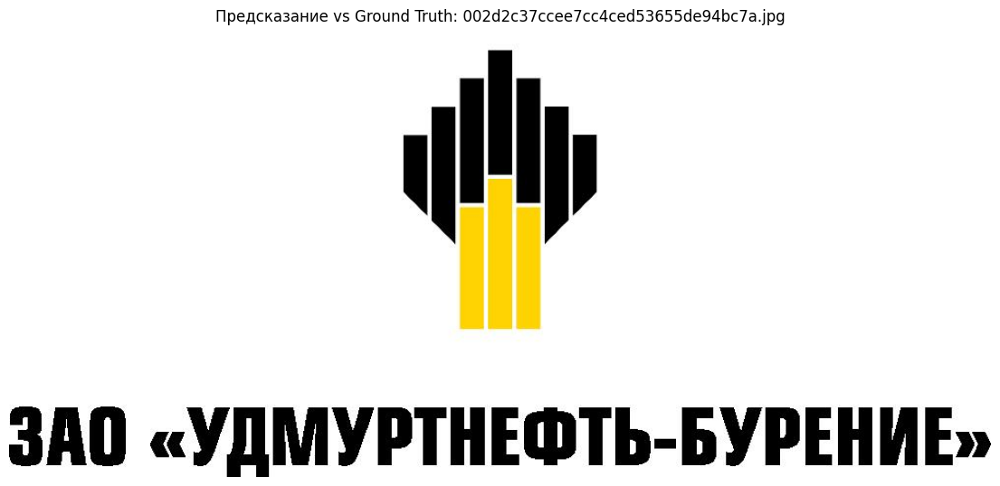

📄 002d2c37ccee7cc4ced53655de94bc7a.jpg — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/0058fb40f9a6b3eb66fc8e554ea285fa.jpg: 512x640 1 tbank_logo, 193.8ms
Speed: 3.9ms preprocess, 193.8ms inference, 1.2ms postprocess per image at shape (1, 3, 512, 640)


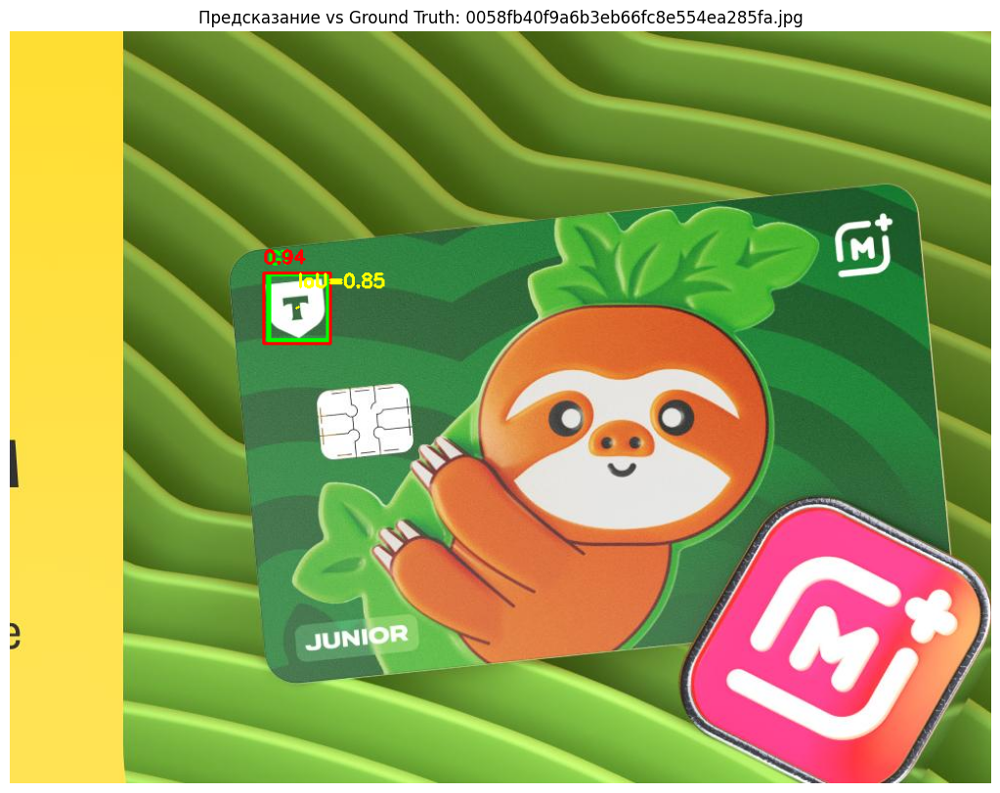

📄 0058fb40f9a6b3eb66fc8e554ea285fa.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/00e0a31f7e80b13b679b8ca1fc4bdc68.jpg: 640x640 (no detections), 311.2ms
Speed: 6.3ms preprocess, 311.2ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


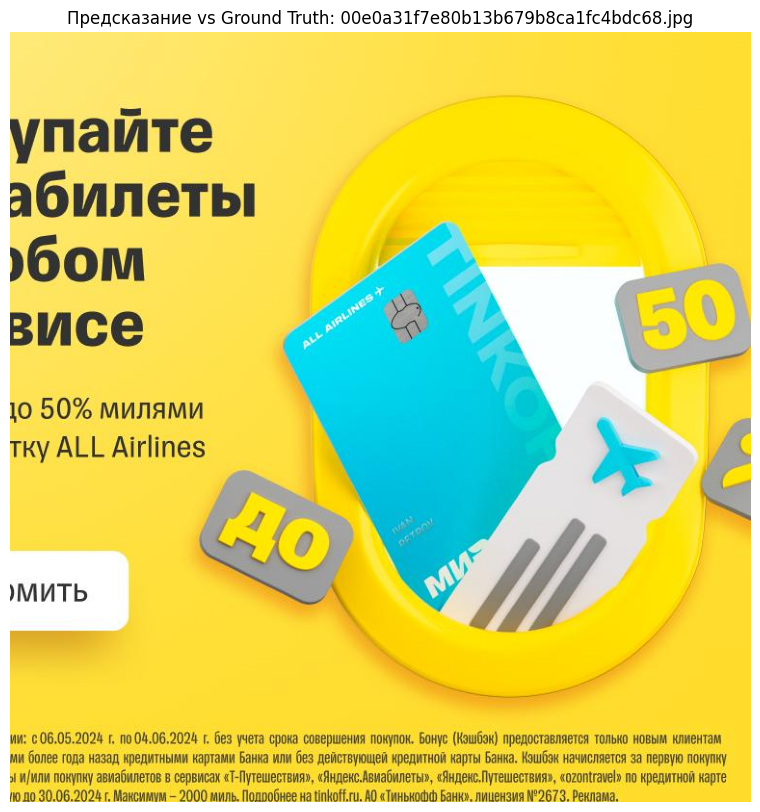

📄 00e0a31f7e80b13b679b8ca1fc4bdc68.jpg — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/00ea00c48be316d27526c4eb33b64557.jpg: 640x160 (no detections), 307.5ms
Speed: 18.9ms preprocess, 307.5ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 160)


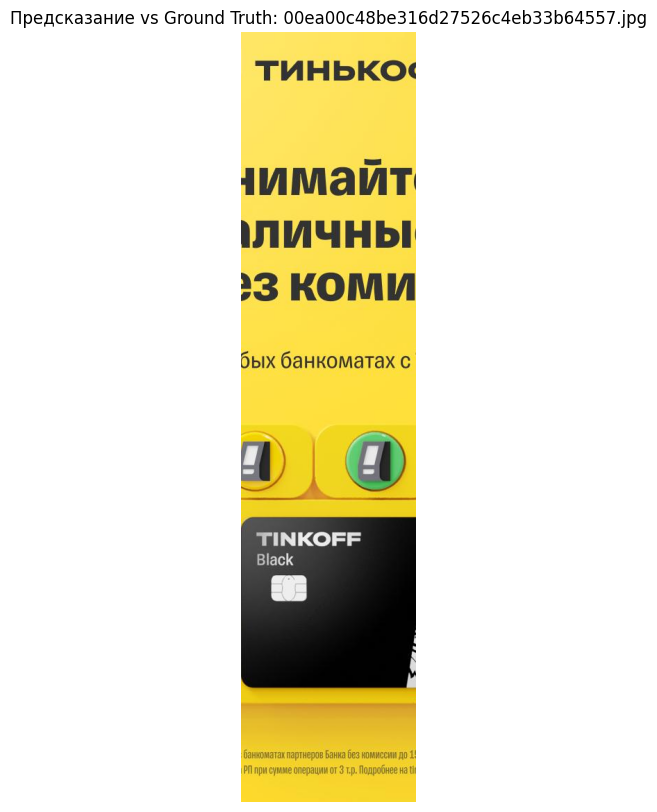

📄 00ea00c48be316d27526c4eb33b64557.jpg — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/015877255cba8943768637005b79a9c3.jpg: 512x640 1 tbank_logo, 548.2ms
Speed: 13.0ms preprocess, 548.2ms inference, 5.1ms postprocess per image at shape (1, 3, 512, 640)


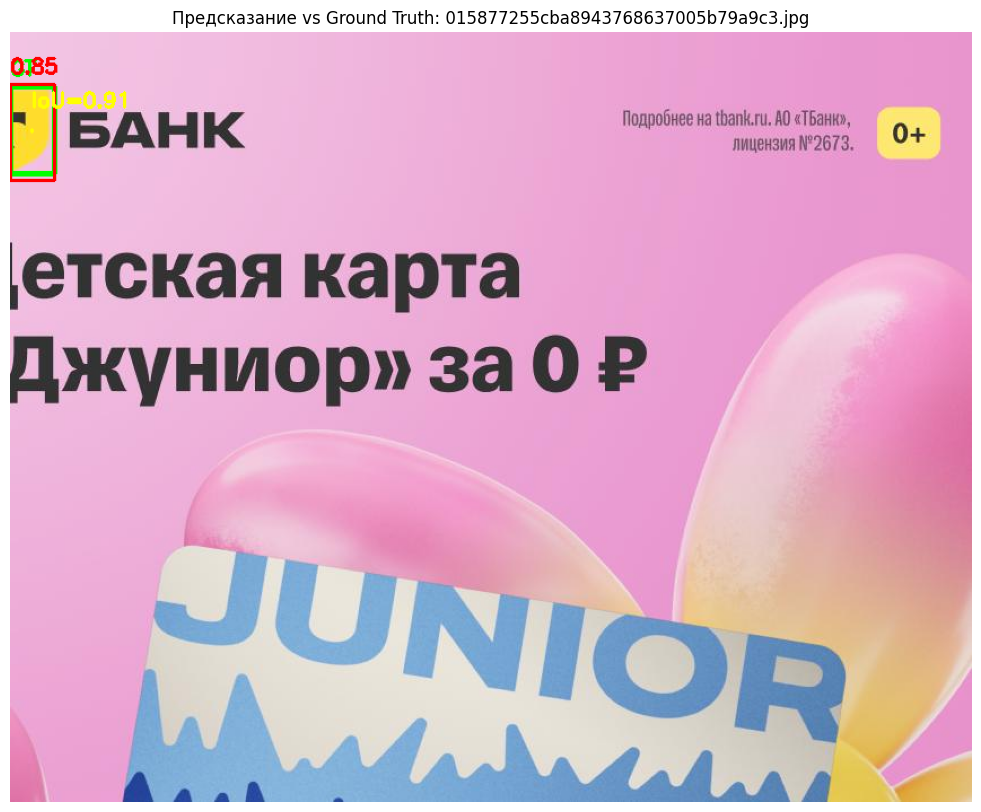

📄 015877255cba8943768637005b79a9c3.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/02774d079c5994791281a529548df519.jpg: 640x192 1 tbank_logo, 162.8ms
Speed: 2.7ms preprocess, 162.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 192)


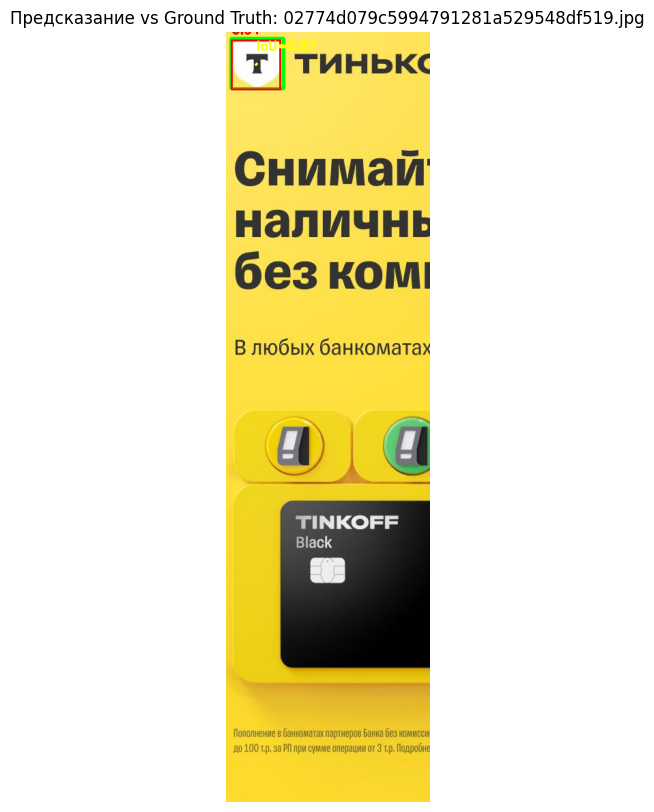

📄 02774d079c5994791281a529548df519.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/03064af0ff2c4dd127d63d7c5a99ab4c.jpg: 640x640 1 tbank_logo, 384.9ms
Speed: 7.3ms preprocess, 384.9ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


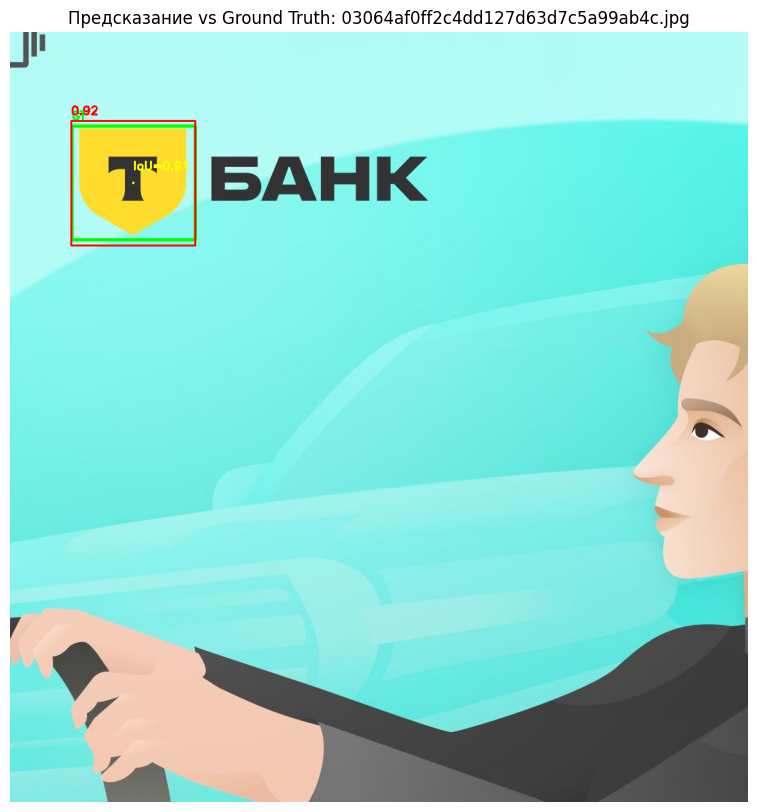

📄 03064af0ff2c4dd127d63d7c5a99ab4c.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/057a559068afe764e94a7b659d0fadc7.jpg: 416x640 1 tbank_logo, 244.8ms
Speed: 4.1ms preprocess, 244.8ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


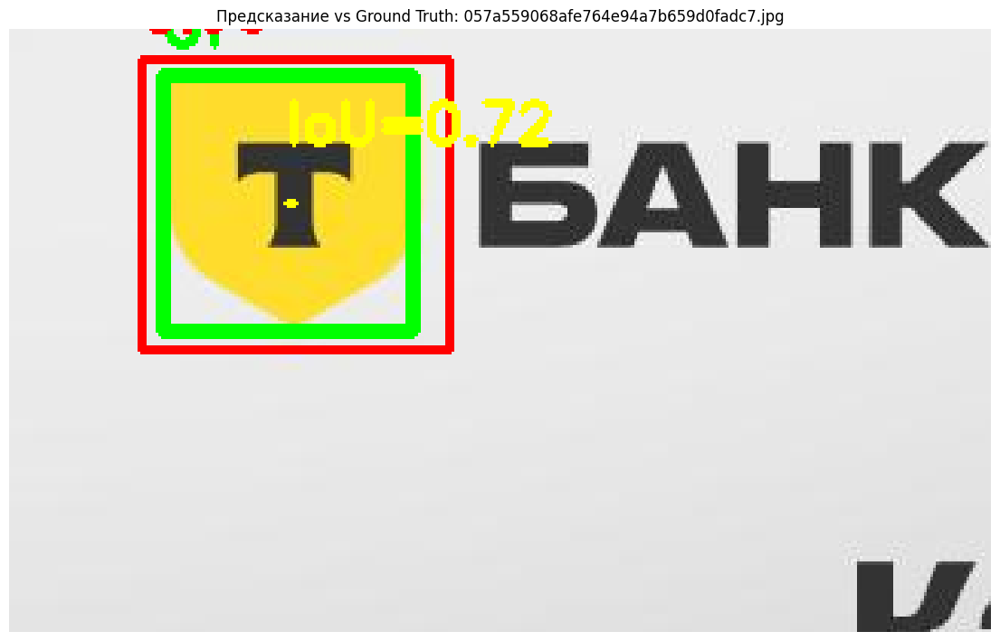

📄 057a559068afe764e94a7b659d0fadc7.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/0605f8b7243ab642acb7ec18c8fab84c.jpg: 640x384 1 tbank_logo, 250.7ms
Speed: 4.5ms preprocess, 250.7ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 384)


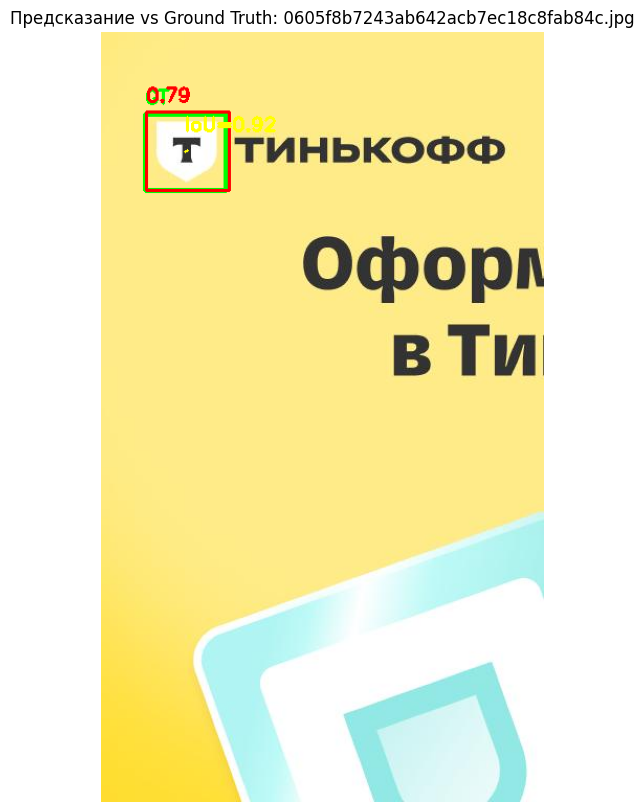

📄 0605f8b7243ab642acb7ec18c8fab84c.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/084953a54fa55d65944b38fbb317760a.jpg: 288x640 1 tbank_logo, 171.6ms
Speed: 3.0ms preprocess, 171.6ms inference, 1.6ms postprocess per image at shape (1, 3, 288, 640)


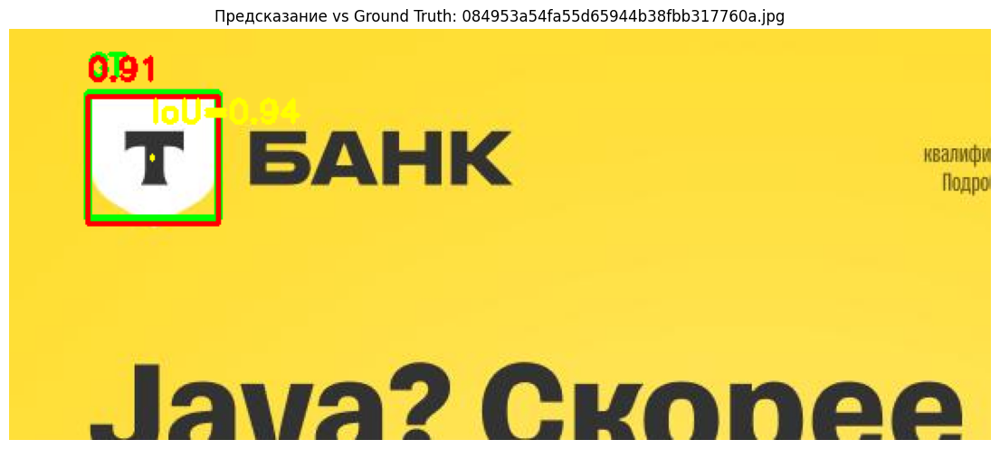

📄 084953a54fa55d65944b38fbb317760a.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/0918e48e20a622c9c5190c4bcc4a5a6b.jpg: 576x640 1 tbank_logo, 342.8ms
Speed: 10.3ms preprocess, 342.8ms inference, 1.5ms postprocess per image at shape (1, 3, 576, 640)


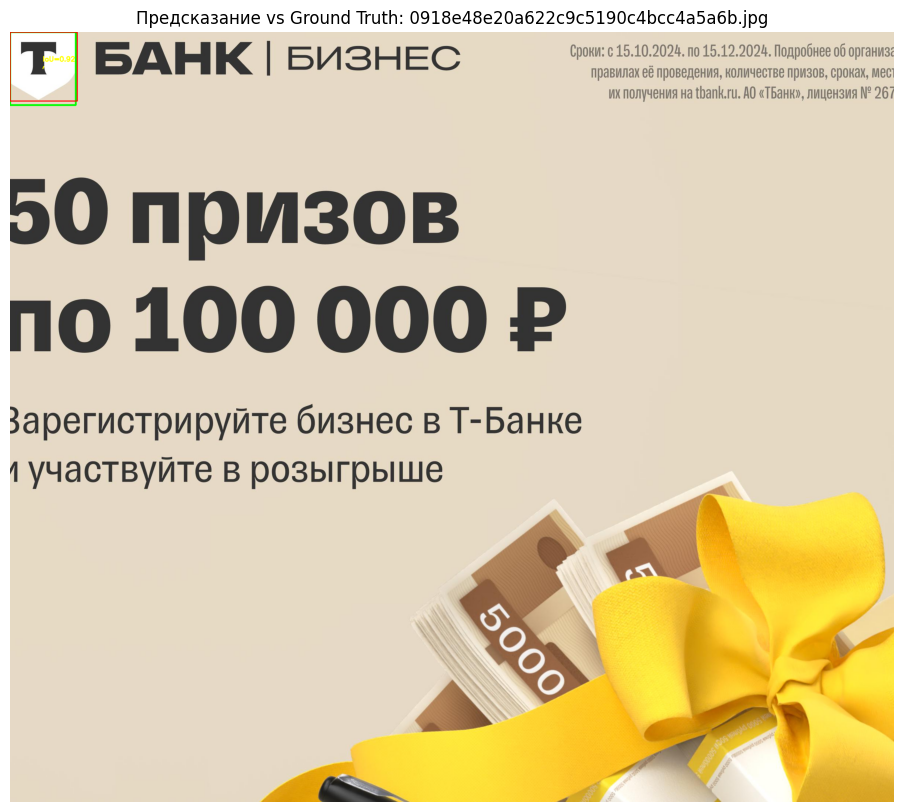

📄 0918e48e20a622c9c5190c4bcc4a5a6b.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/0bb871f1c34bb159c8d2f3ed4211bf02.jpg: 384x640 1 tbank_logo, 259.5ms
Speed: 4.4ms preprocess, 259.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


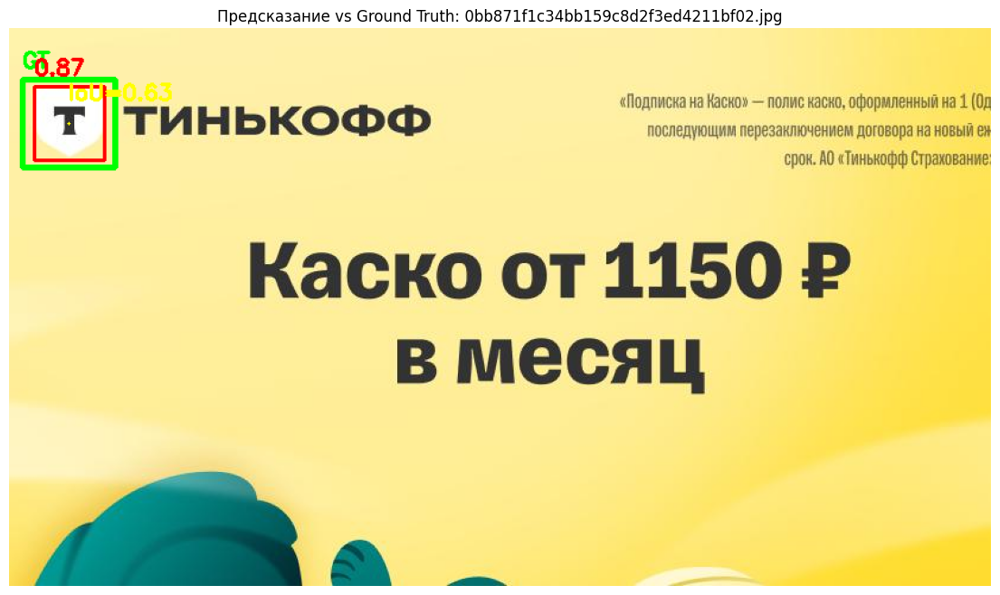

📄 0bb871f1c34bb159c8d2f3ed4211bf02.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/0d7551e6c05691a9bab701bae594c96f.jpg: 640x192 1 tbank_logo, 144.2ms
Speed: 3.0ms preprocess, 144.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 192)


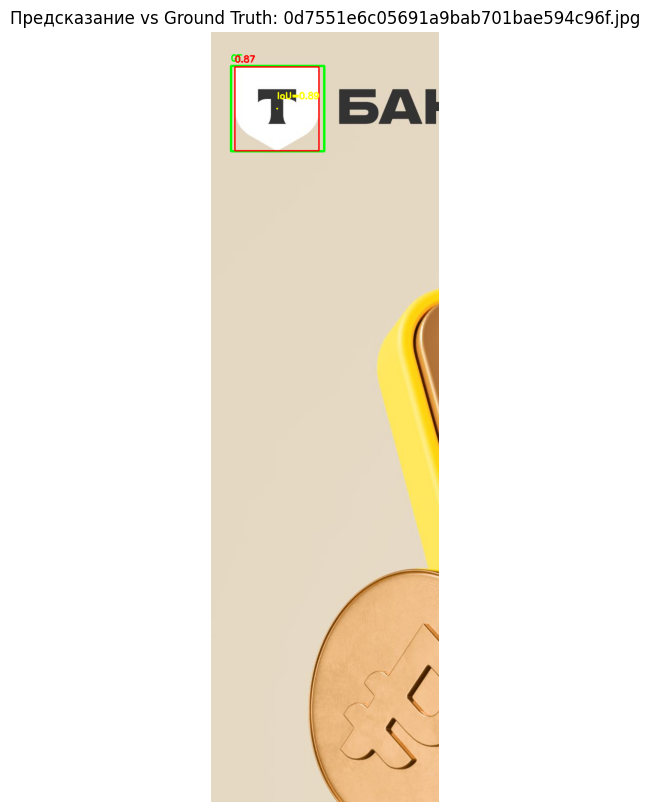

📄 0d7551e6c05691a9bab701bae594c96f.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/0f8ef17a0113522427cb4a74f9eb90ba.jpg: 640x512 1 tbank_logo, 387.5ms
Speed: 7.4ms preprocess, 387.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 512)


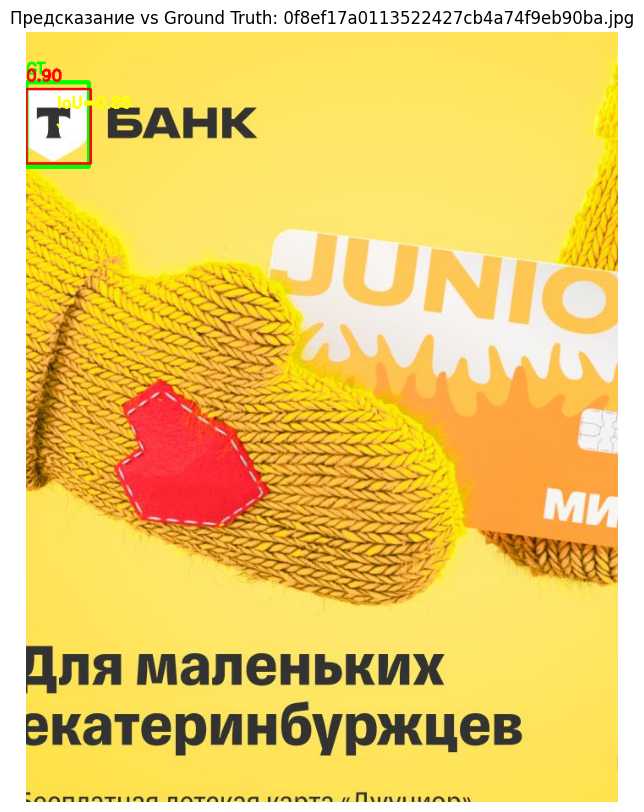

📄 0f8ef17a0113522427cb4a74f9eb90ba.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/0fdf16e4579e9c6ddc69293182a06d24.jpg: 608x640 1 tbank_logo, 395.8ms
Speed: 9.3ms preprocess, 395.8ms inference, 1.8ms postprocess per image at shape (1, 3, 608, 640)


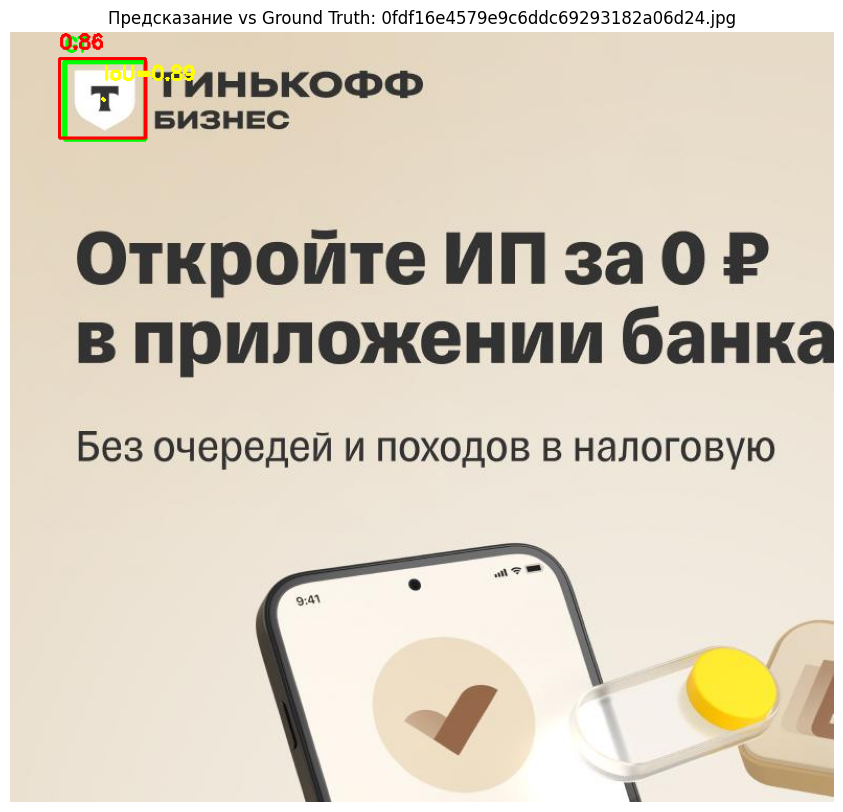

📄 0fdf16e4579e9c6ddc69293182a06d24.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/0fe24d94c342d2ba7d036af57c37be69.jpg: 640x448 1 tbank_logo, 301.1ms
Speed: 5.1ms preprocess, 301.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 448)


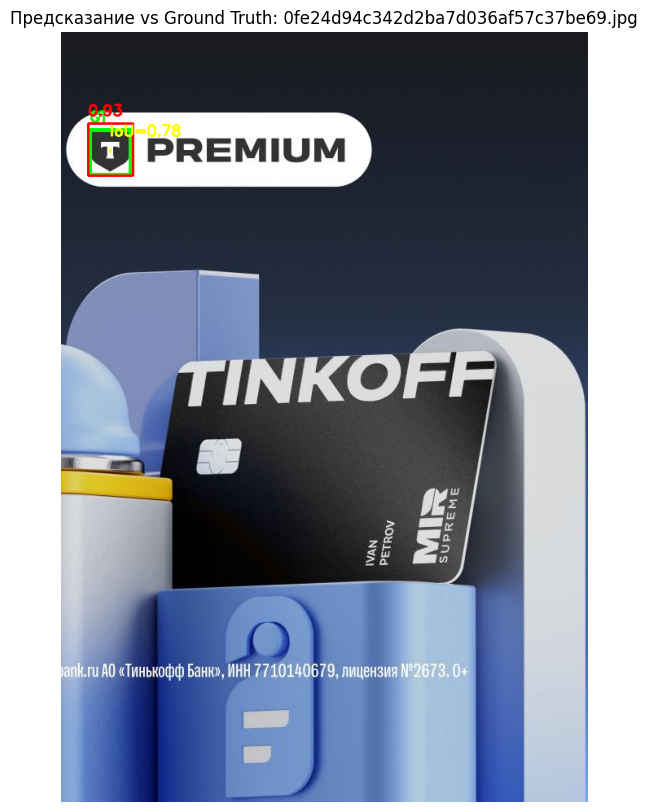

📄 0fe24d94c342d2ba7d036af57c37be69.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/0ff232a635f2e2255cf3fa4934843a71.jpg: 640x576 1 tbank_logo, 402.4ms
Speed: 10.6ms preprocess, 402.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 576)


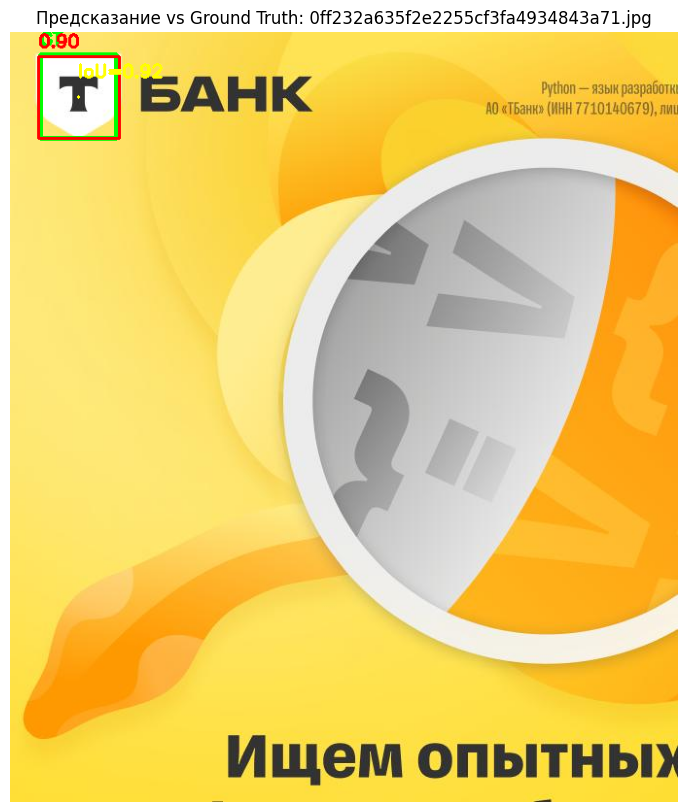

📄 0ff232a635f2e2255cf3fa4934843a71.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/10474e24963e797cd1b109ee69ed131b.jpg: 640x640 1 tbank_logo, 414.0ms
Speed: 10.9ms preprocess, 414.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


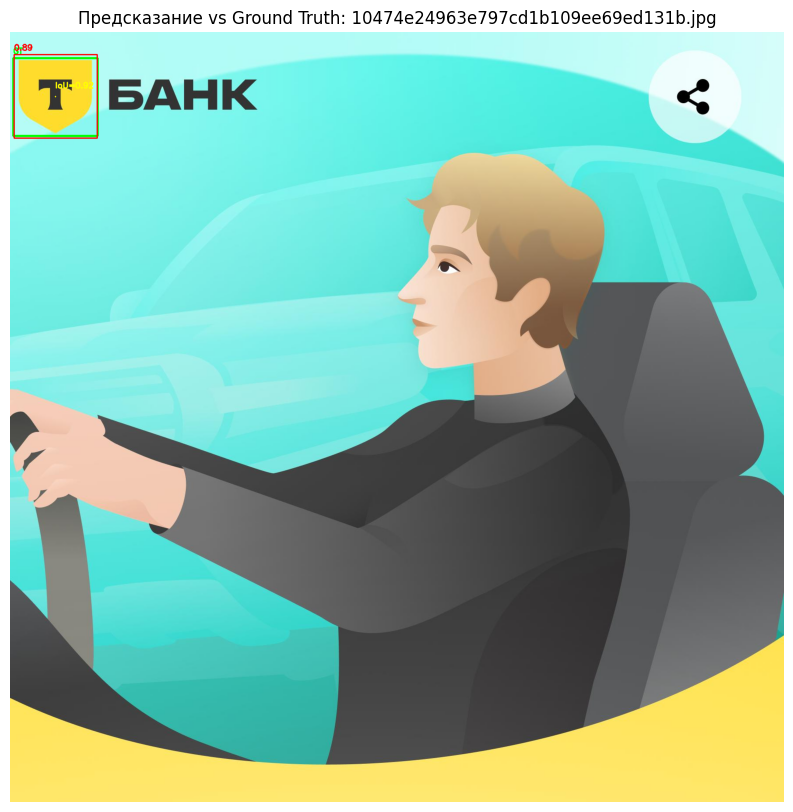

📄 10474e24963e797cd1b109ee69ed131b.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/10cd93a3a7555c4d1020dad3e416507c.jpg: 160x640 1 tbank_logo, 152.6ms
Speed: 1.9ms preprocess, 152.6ms inference, 1.5ms postprocess per image at shape (1, 3, 160, 640)


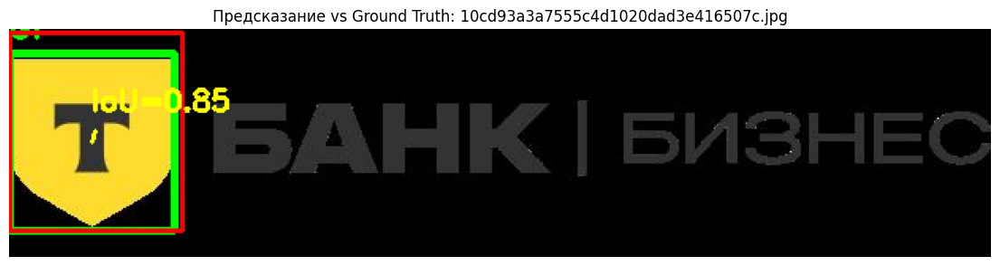

📄 10cd93a3a7555c4d1020dad3e416507c.jpg — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/2025-09-14_18-03-46.png: 288x640 1 tbank_logo, 176.4ms
Speed: 3.7ms preprocess, 176.4ms inference, 1.5ms postprocess per image at shape (1, 3, 288, 640)


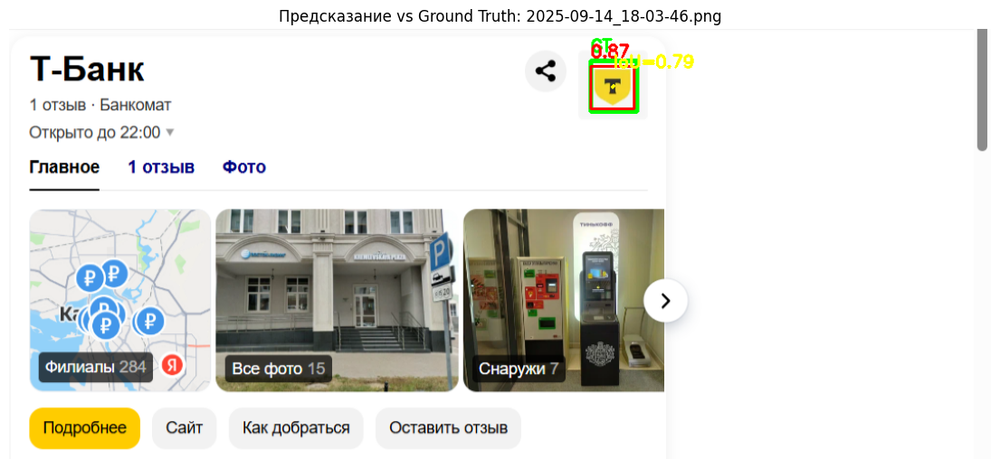

📄 2025-09-14_18-03-46.png — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/2025-09-14_18-04-23.png: 640x640 3 tbank_logos, 381.5ms
Speed: 6.5ms preprocess, 381.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


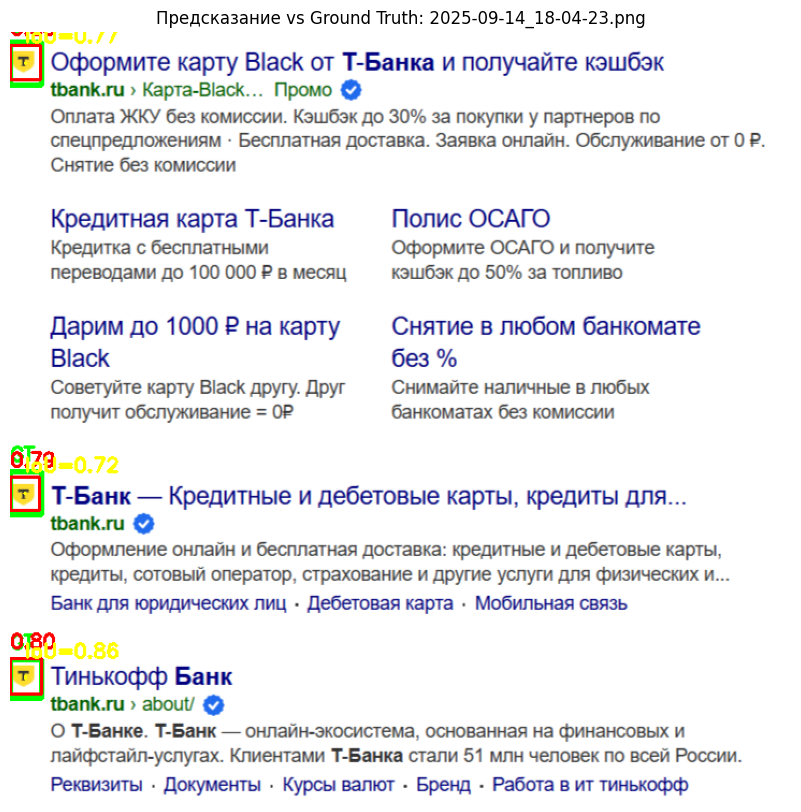

📄 2025-09-14_18-04-23.png — GT: 3, Pred: 3
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/2025-09-14_18-05-10.png: 96x640 1 tbank_logo, 86.9ms
Speed: 1.4ms preprocess, 86.9ms inference, 1.0ms postprocess per image at shape (1, 3, 96, 640)


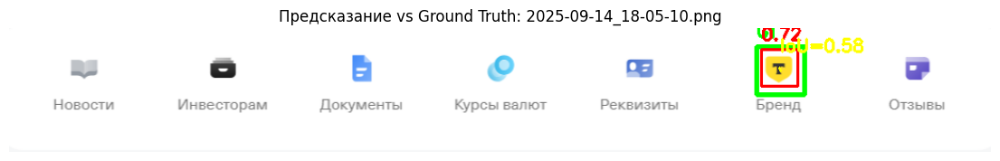

📄 2025-09-14_18-05-10.png — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/2025-09-14_18-05-37.png: 544x640 1 tbank_logo, 383.1ms
Speed: 9.3ms preprocess, 383.1ms inference, 1.8ms postprocess per image at shape (1, 3, 544, 640)


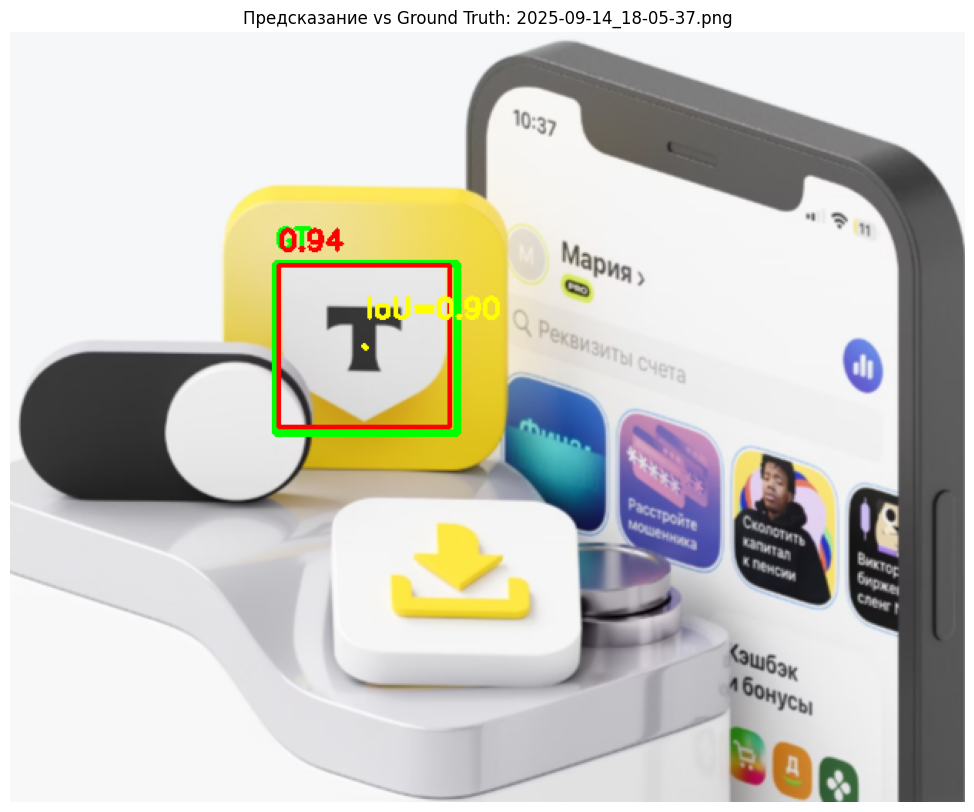

📄 2025-09-14_18-05-37.png — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/2025-09-14_18-06-18.png: 256x640 4 tbank_logos, 174.6ms
Speed: 3.3ms preprocess, 174.6ms inference, 1.3ms postprocess per image at shape (1, 3, 256, 640)


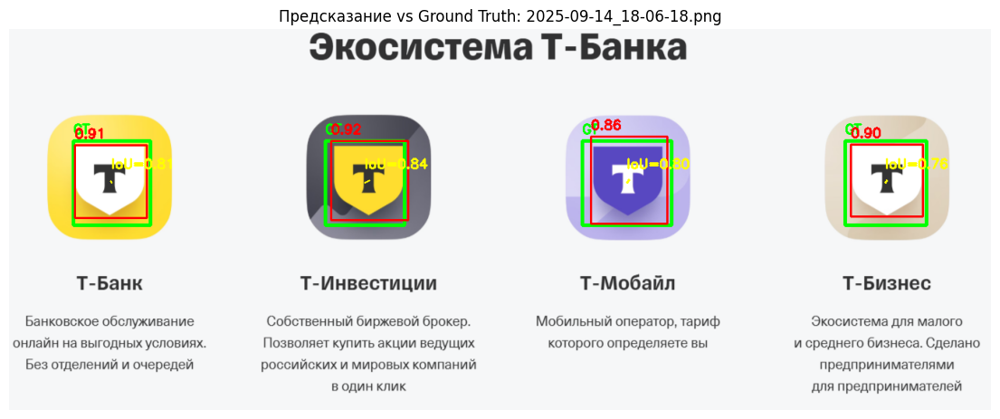

📄 2025-09-14_18-06-18.png — GT: 4, Pred: 4
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/2025-09-14_18-07-43.png: 192x640 1 tbank_logo, 165.7ms
Speed: 3.9ms preprocess, 165.7ms inference, 1.9ms postprocess per image at shape (1, 3, 192, 640)


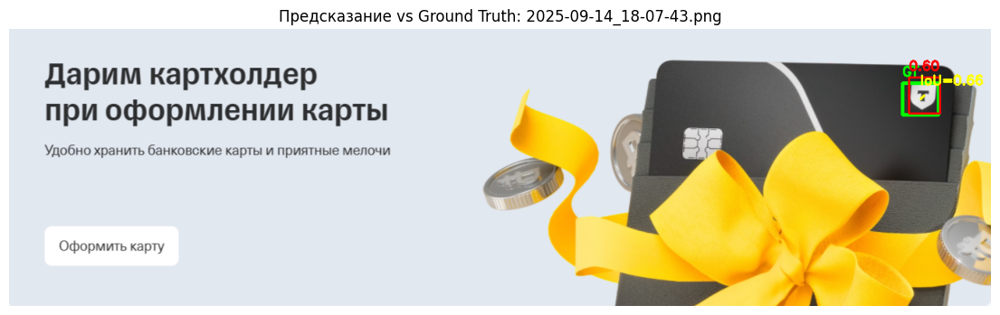

📄 2025-09-14_18-07-43.png — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/2025-09-14_18-09-03.png: 256x640 (no detections), 162.6ms
Speed: 4.1ms preprocess, 162.6ms inference, 0.9ms postprocess per image at shape (1, 3, 256, 640)


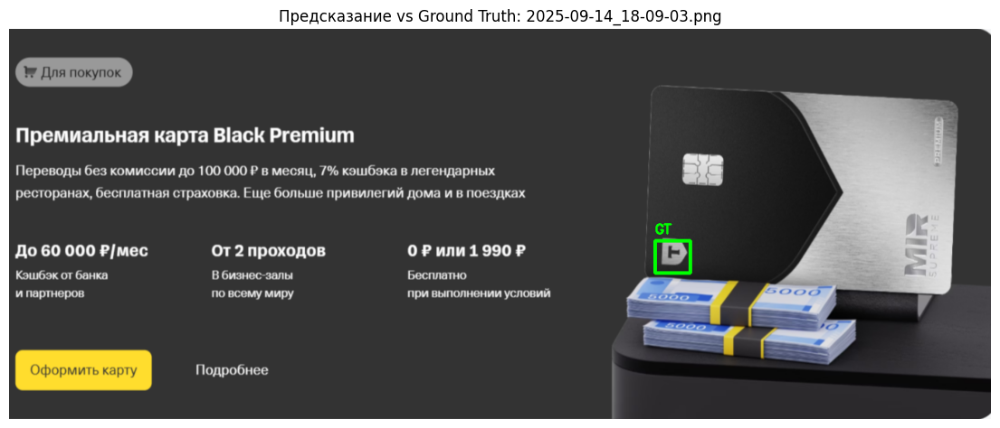

📄 2025-09-14_18-09-03.png — GT: 1, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/332010517c135389d1de68d902fd29e0.jpg: 320x640 (no detections), 199.4ms
Speed: 3.9ms preprocess, 199.4ms inference, 0.9ms postprocess per image at shape (1, 3, 320, 640)


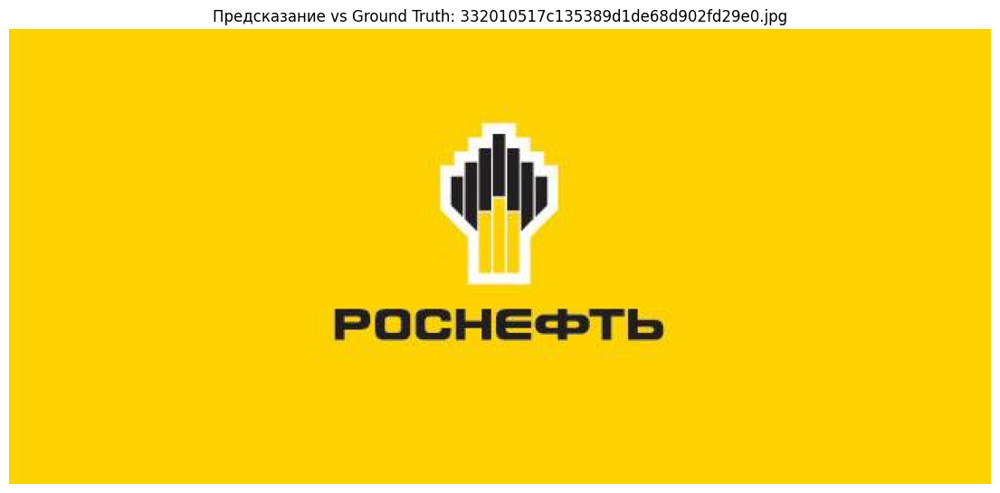

📄 332010517c135389d1de68d902fd29e0.jpg — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/3a1cda06bf9db3d9c2a5a79a067f01e3.jpg: 640x352 (no detections), 213.8ms
Speed: 4.2ms preprocess, 213.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 352)


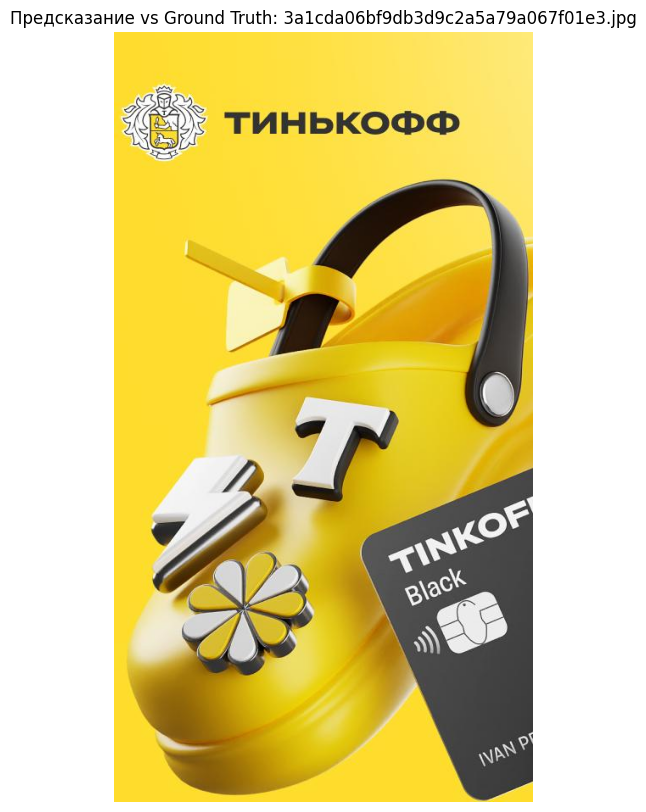

📄 3a1cda06bf9db3d9c2a5a79a067f01e3.jpg — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/3c5686a40cdea03d27524d8a24f6367d.jpg: 416x640 (no detections), 246.5ms
Speed: 6.7ms preprocess, 246.5ms inference, 1.1ms postprocess per image at shape (1, 3, 416, 640)


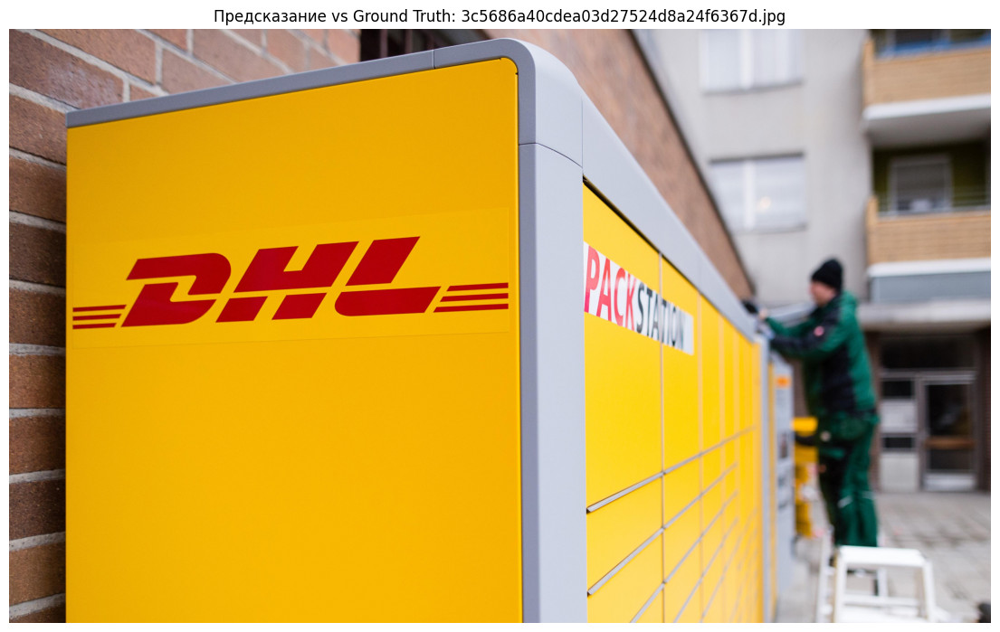

📄 3c5686a40cdea03d27524d8a24f6367d.jpg — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (1).webp: 480x640 1 tbank_logo, 291.9ms
Speed: 5.0ms preprocess, 291.9ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


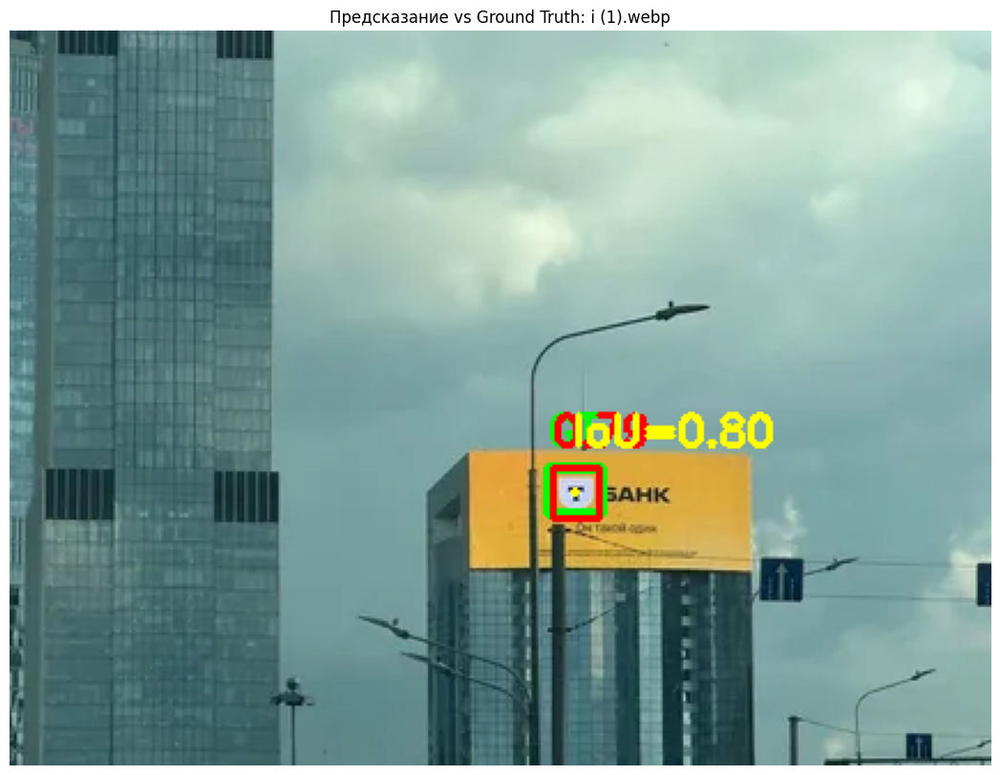

📄 i (1).webp — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (10).jpg: 448x640 (no detections), 322.0ms
Speed: 7.1ms preprocess, 322.0ms inference, 1.1ms postprocess per image at shape (1, 3, 448, 640)


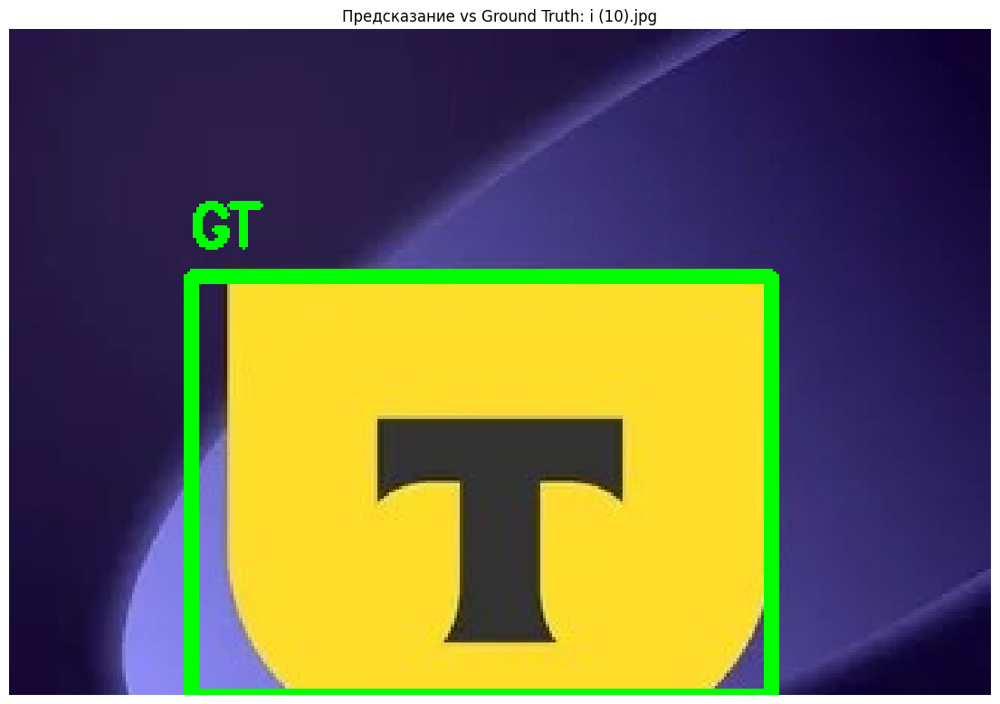

📄 i (10).jpg — GT: 1, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (11).jpg: 640x416 (no detections), 246.6ms
Speed: 4.0ms preprocess, 246.6ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 416)


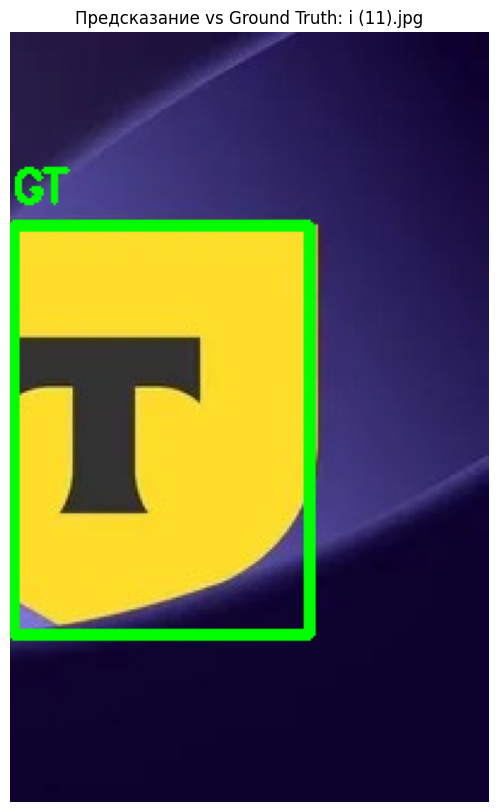

📄 i (11).jpg — GT: 1, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (12).webp: 448x640 1 tbank_logo, 269.2ms
Speed: 4.6ms preprocess, 269.2ms inference, 5.0ms postprocess per image at shape (1, 3, 448, 640)


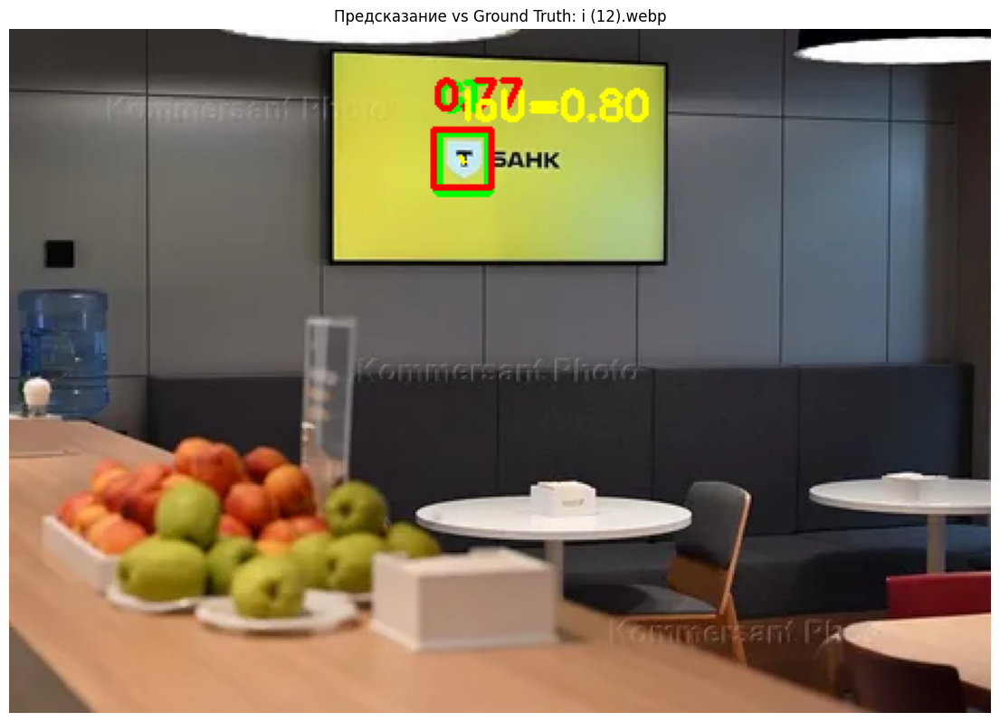

📄 i (12).webp — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (2).webp: 384x640 3 tbank_logos, 218.8ms
Speed: 6.0ms preprocess, 218.8ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


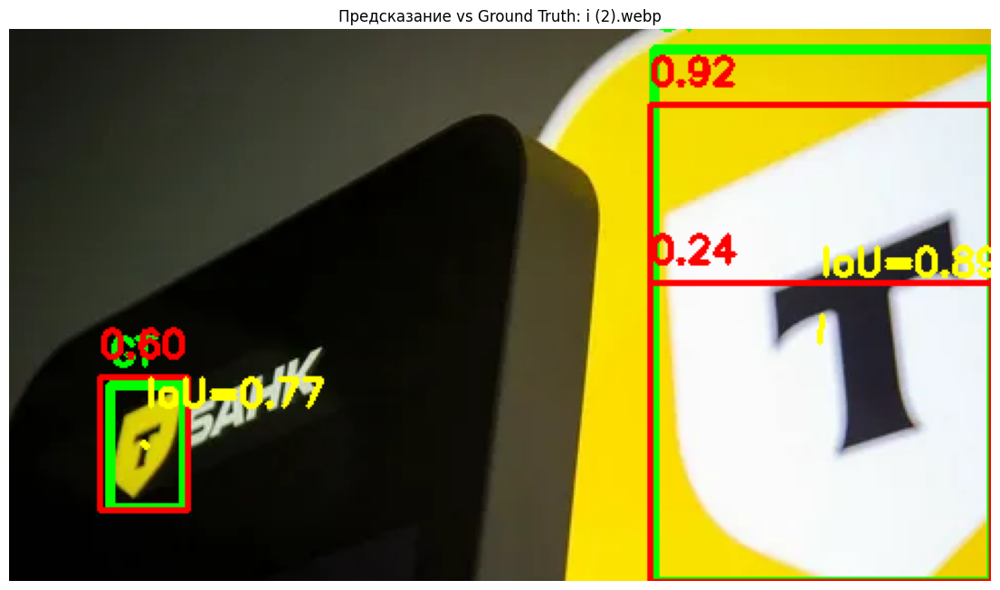

📄 i (2).webp — GT: 2, Pred: 3
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (3).webp: 512x640 1 tbank_logo, 349.9ms
Speed: 4.6ms preprocess, 349.9ms inference, 1.6ms postprocess per image at shape (1, 3, 512, 640)


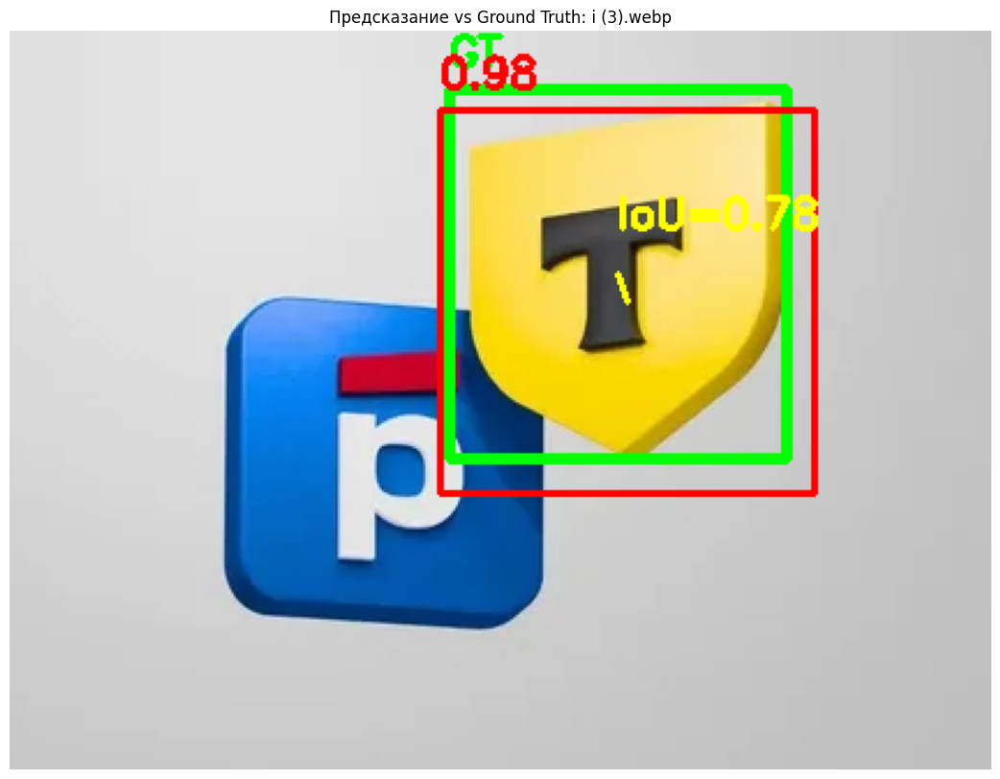

📄 i (3).webp — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (4).webp: 640x640 (no detections), 374.1ms
Speed: 5.2ms preprocess, 374.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


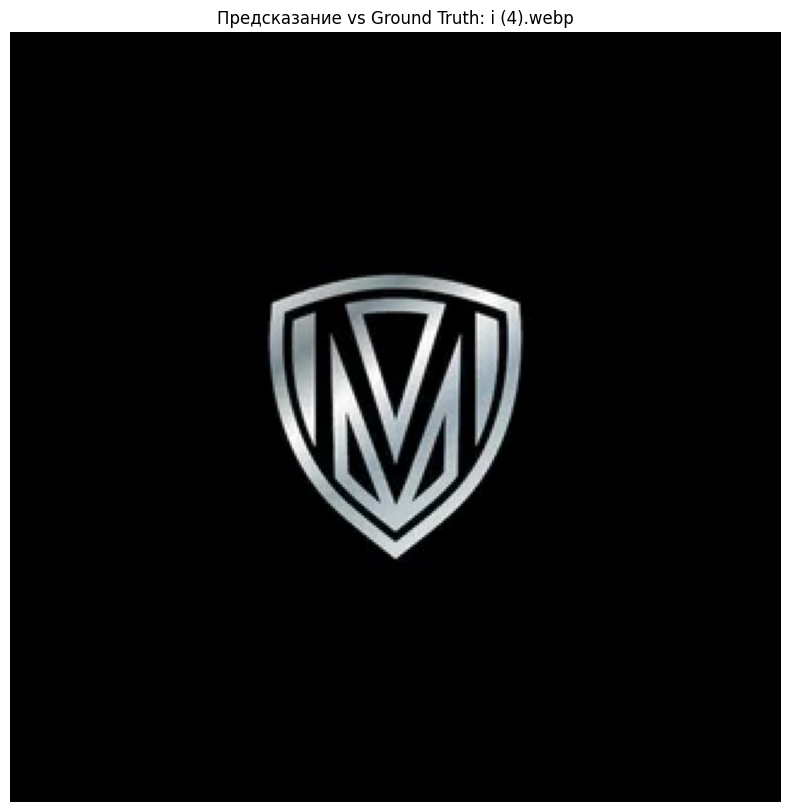

📄 i (4).webp — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (5).webp: 640x640 (no detections), 354.1ms
Speed: 6.2ms preprocess, 354.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


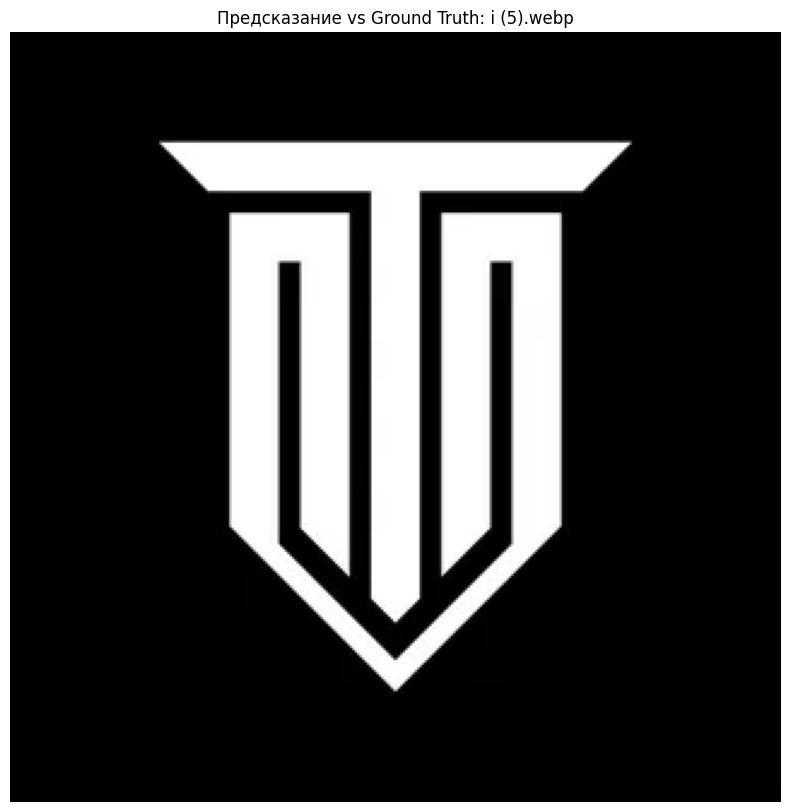

📄 i (5).webp — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (6).webp: 640x640 (no detections), 362.4ms
Speed: 6.3ms preprocess, 362.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


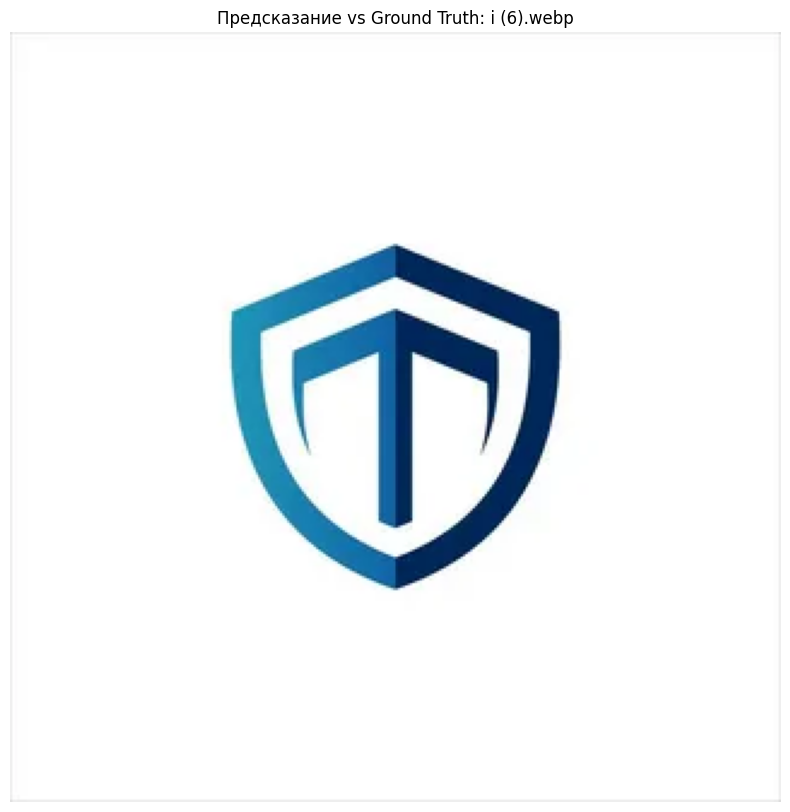

📄 i (6).webp — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (7).webp: 160x640 (no detections), 102.6ms
Speed: 1.8ms preprocess, 102.6ms inference, 1.0ms postprocess per image at shape (1, 3, 160, 640)


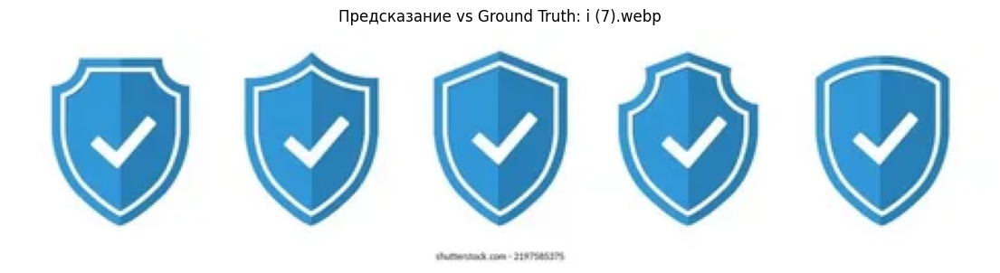

📄 i (7).webp — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (8).webp: 640x640 (no detections), 398.2ms
Speed: 5.1ms preprocess, 398.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


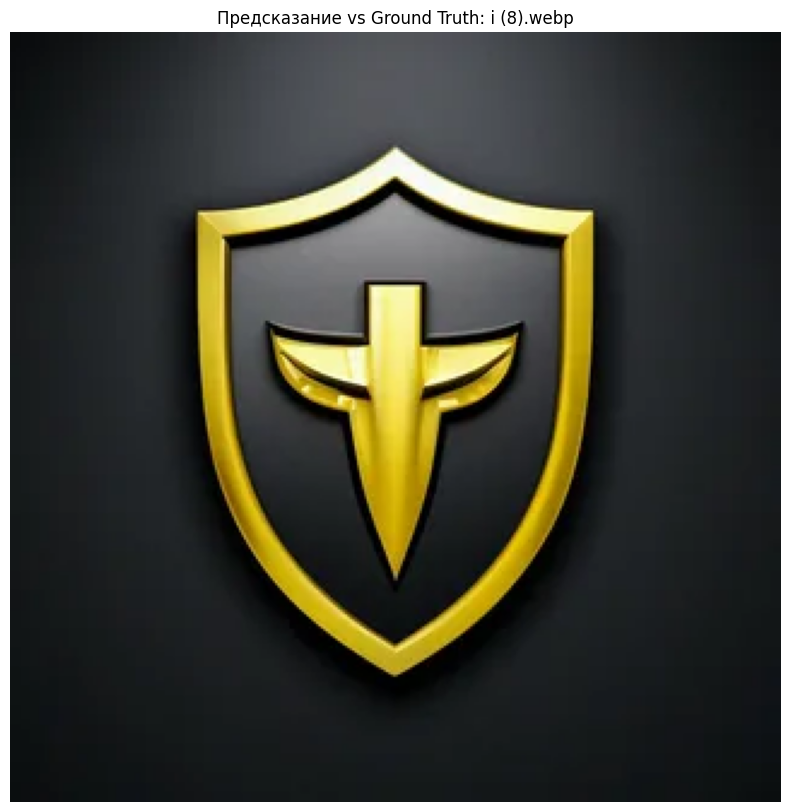

📄 i (8).webp — GT: 0, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i (9).webp: 640x640 (no detections), 430.8ms
Speed: 5.3ms preprocess, 430.8ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


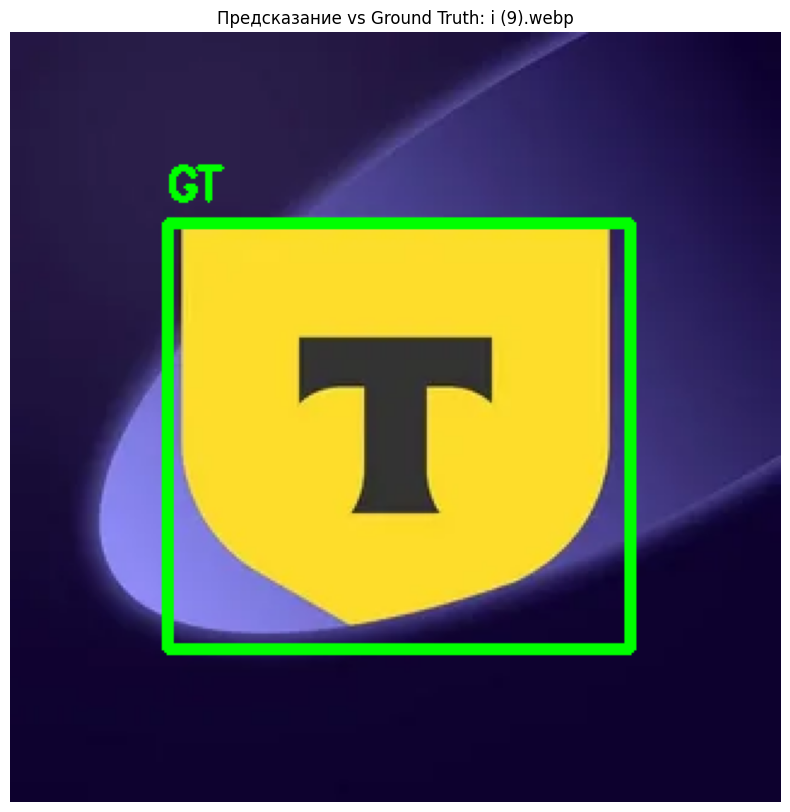

📄 i (9).webp — GT: 1, Pred: 0
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i3.webp: 480x640 1 tbank_logo, 319.4ms
Speed: 4.3ms preprocess, 319.4ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 640)


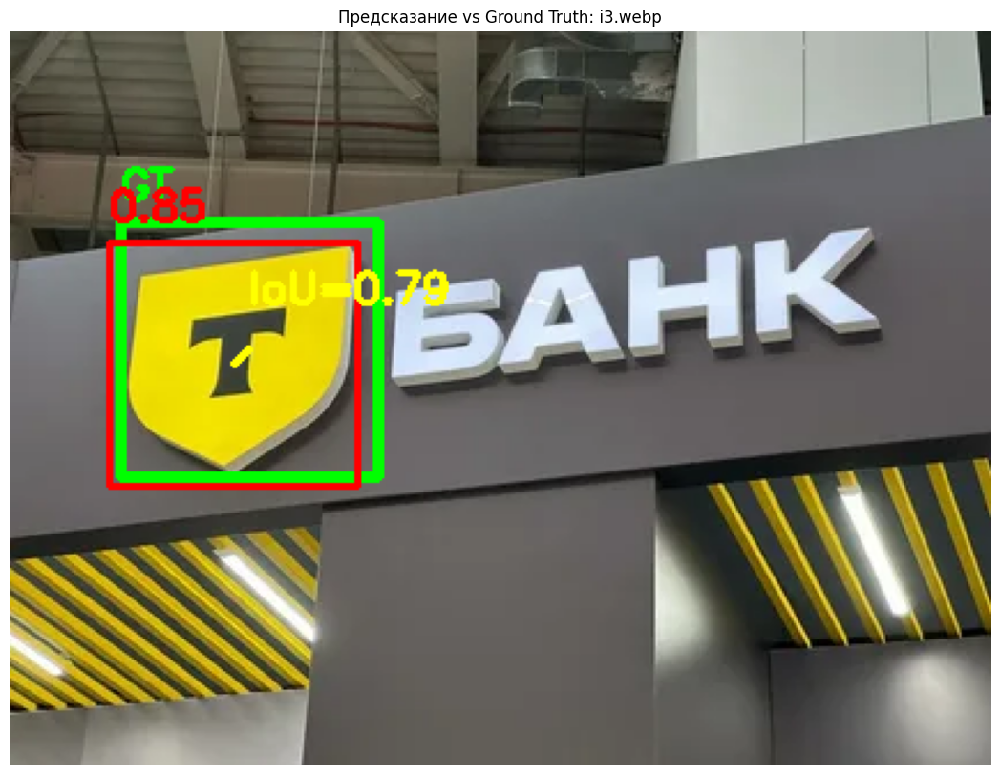

📄 i3.webp — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i5.webp: 384x640 1 tbank_logo, 233.4ms
Speed: 3.8ms preprocess, 233.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


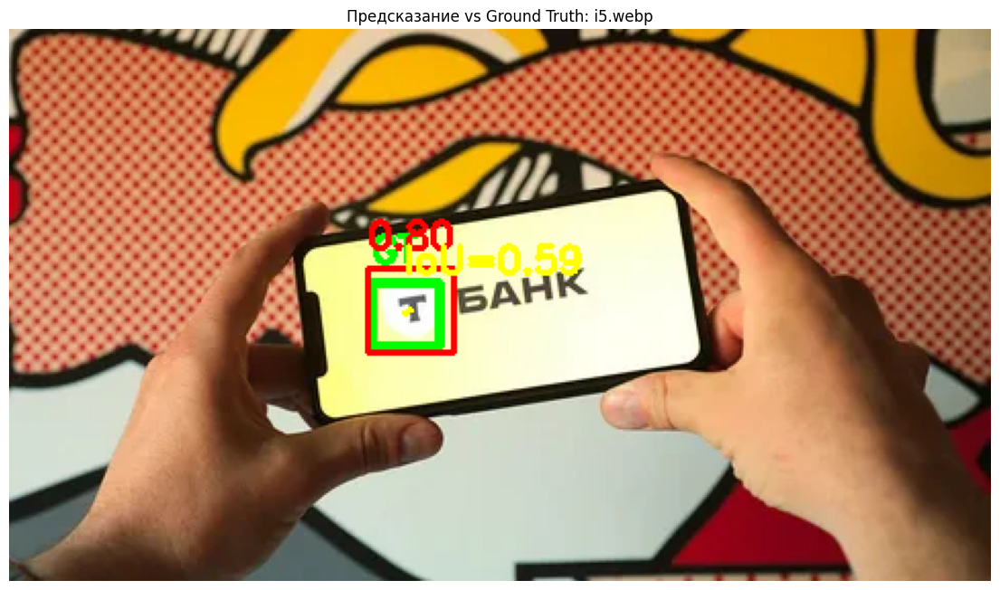

📄 i5.webp — GT: 1, Pred: 1
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i6.webp: 448x640 2 tbank_logos, 277.2ms
Speed: 11.6ms preprocess, 277.2ms inference, 1.6ms postprocess per image at shape (1, 3, 448, 640)


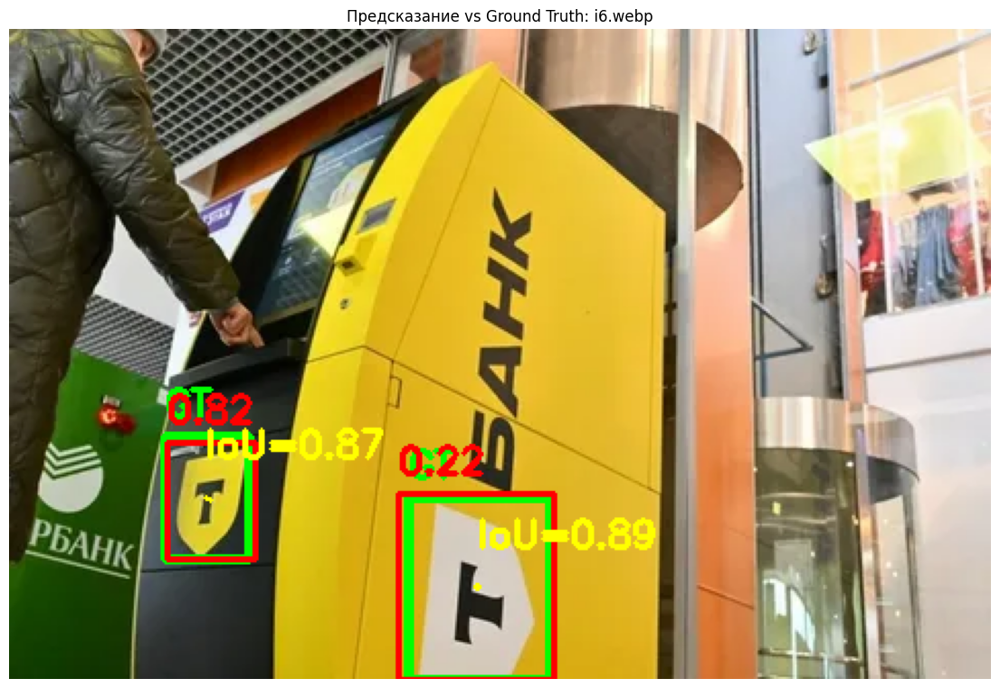

📄 i6.webp — GT: 2, Pred: 2
--------------------------------------------------------------------------------

image 1/1 /content/drive/MyDrive/SIRIUS/dataset_2/images/val/i8.webp: 448x640 1 tbank_logo, 267.0ms
Speed: 5.5ms preprocess, 267.0ms inference, 1.9ms postprocess per image at shape (1, 3, 448, 640)


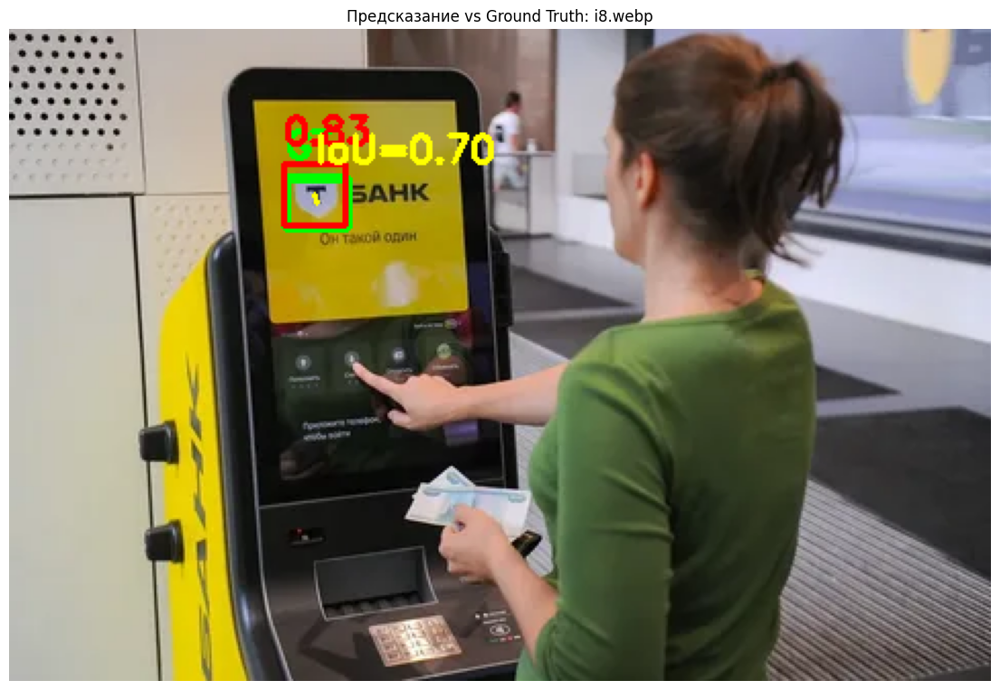

📄 i8.webp — GT: 1, Pred: 1
--------------------------------------------------------------------------------


In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path

# ========================
# НАСТРОЙКИ
# ========================

VAL_IMAGE_DIR = "/content/drive/MyDrive/SIRIUS/dataset_2/images/val"
VAL_LABEL_DIR = "/content/drive/MyDrive/SIRIUS/dataset_2/labels/val"
CONF_THRESHOLD = 0.2  # порог уверенности для отображения предсказаний

# ========================
# ФУНКЦИЯ ВЫЧИСЛЕНИЯ IoU
# ========================

def bbox_iou(box1, box2):
    """
    Вычисляет IoU между двумя bounding box'ами в формате [x1, y1, x2, y2]
    """
    x1 = max(box1[0], box2[0])
    y1 = max(box1[1], box2[1])
    x2 = min(box1[2], box2[2])
    y2 = min(box1[3], box2[3])

    if x2 <= x1 or y2 <= y1:
        return 0.0

    intersection = (x2 - x1) * (y2 - y1)
    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])
    union = box1_area + box2_area - intersection

    return intersection / union if union > 0 else 0.0

# ========================
# ПРОХОД ПО ВСЕМ ИЗОБРАЖЕНИЯМ В VAL
# ========================

val_images = sorted([f for f in os.listdir(VAL_IMAGE_DIR) if f.lower()])

for img_file in val_images:
    img_path = os.path.join(VAL_IMAGE_DIR, img_file)
    label_path = os.path.join(VAL_LABEL_DIR, Path(img_file).stem + ".txt")

    # Загружаем изображение
    img = cv2.imread(img_path)
    if img is None:
        print(f"⚠️  Не удалось загрузить: {img_file}")
        continue
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    h_img, w_img = img.shape[:2]

    # Создаём копию для отрисовки
    img_display = img_rgb.copy()

    # Загружаем ground truth (зелёные рамки)
    gt_boxes = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f.readlines():
                parts = line.strip().split()
                if len(parts) < 5:
                    continue
                _, x_center, y_center, width, height = map(float, parts)
                x1 = int((x_center - width / 2) * w_img)
                y1 = int((y_center - height / 2) * h_img)
                x2 = int((x_center + width / 2) * w_img)
                y2 = int((y_center + height / 2) * h_img)
                gt_boxes.append([x1, y1, x2, y2])
                # Рисуем GT рамку
                cv2.rectangle(img_display, (x1, y1), (x2, y2), (0, 255, 0), 3)  # зелёный
                cv2.putText(img_display, "GT", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    # Предсказания модели (красные рамки)
    results = model(img_path, conf=CONF_THRESHOLD)
    pred_boxes = []
    for box in results[0].boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0])
        conf = box.conf[0].item()
        pred_boxes.append([x1, y1, x2, y2, conf])
        # Рисуем предсказание
        cv2.rectangle(img_display, (x1, y1), (x2, y2), (255, 0, 0), 2)  # красный
        cv2.putText(img_display, f"{conf:.2f}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 0, 0), 2)

    # Вычисляем IoU для каждого GT с лучшим предсказанием
    for i, gt_box in enumerate(gt_boxes):
        best_iou = 0
        best_pred = None
        for pred_box in pred_boxes:
            iou = bbox_iou(gt_box, pred_box[:4])
            if iou > best_iou:
                best_iou = iou
                best_pred = pred_box

        if best_pred is not None:
            # Рисуем линию между GT и предсказанием
            gt_center = ((gt_box[0] + gt_box[2]) // 2, (gt_box[1] + gt_box[3]) // 2)
            pred_center = ((best_pred[0] + best_pred[2]) // 2, (best_pred[1] + best_pred[3]) // 2)
            cv2.line(img_display, gt_center, pred_center, (255, 255, 0), 2)
            # Подписываем IoU
            cv2.putText(img_display, f"IoU={best_iou:.2f}", (gt_center[0], gt_center[1] - 20), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 0), 2)

    # Показываем изображение
    plt.figure(figsize=(14, 10))
    plt.imshow(img_display)
    plt.title(f"Предсказание vs Ground Truth: {img_file}")
    plt.axis('off')
    plt.show()

    print(f"📄 {img_file} — GT: {len(gt_boxes)}, Pred: {len(pred_boxes)}")
    print("-" * 80)

In [10]:
import matplotlib.pyplot as plt

# Список порогов для тестирования
conf_thresholds = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]

results = []

for conf in conf_thresholds:
    print(f"\n=== Порог уверенности: {conf} ===")
    metrics = model.val(conf=conf, verbose=False)  # verbose=False — чтобы не засорять вывод

    precision = metrics.box.mp
    recall = metrics.box.mr
    map50 = metrics.box.map50
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0

    results.append({
        'conf': conf,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'map50': map50
    })

    print(f"📊 Precision:  {precision:.3f}")
    print(f"📊 Recall:     {recall:.3f}")
    print(f"📊 F1-score:   {f1:.3f}")


=== Порог уверенности: 0.1 ===
Ultralytics 8.3.201 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
val: Fast image access ✅ (ping: 0.6±0.2 ms, read: 45.0±56.7 MB/s, size: 175.6 KB)
val: Scanning /content/drive/MyDrive/SIRIUS/dataset_2/labels/val... 47 images, 11 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 52/52 5.3it/s 9.7s
val: New cache created: /content/drive/MyDrive/SIRIUS/dataset_2/labels/val.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 4/4 0.3it/s 13.8s
                   all         52         48      0.976      0.831      0.912      0.589
Speed: 6.0ms preprocess, 231.9ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to /content/runs/detect/val11
📊 Precision:  0.976
📊 Recall:     0.831
📊 F1-score:   0.897

=== Порог уверенности: 0.2 ===
Ultralytics 8.3.201 🚀 Python-3.12.11 torch-2.8.0+cu126 CPU (Intel Xeon CPU @ 2.20GHz)
val: Fast image access ✅ (ping: 0.8±0.5 ms, read: 66.8±

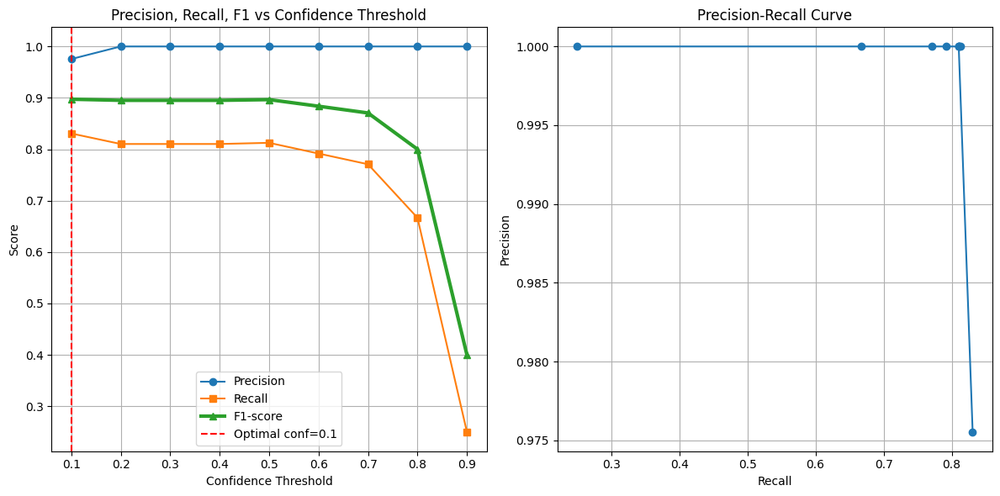


🏆 Оптимальный порог уверенности по F1-score: 0.1
   F1-score: 0.897
   Precision: 0.976
   Recall: 0.831


In [11]:
# Извлекаем данные для графиков
confs = [r['conf'] for r in results]
precisions = [r['precision'] for r in results]
recalls = [r['recall'] for r in results]
f1s = [r['f1'] for r in results]

# Строим график
plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(confs, precisions, label='Precision', marker='o')
plt.plot(confs, recalls, label='Recall', marker='s')
plt.plot(confs, f1s, label='F1-score', marker='^', linewidth=3)
plt.xlabel('Confidence Threshold')
plt.ylabel('Score')
plt.title('Precision, Recall, F1 vs Confidence Threshold')
plt.legend()
plt.grid(True)

# Находим оптимальный порог по F1
optimal = max(results, key=lambda x: x['f1'])
plt.axvline(x=optimal['conf'], color='red', linestyle='--', label=f'Optimal conf={optimal["conf"]}')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(recalls, precisions, marker='o')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.grid(True)

plt.tight_layout()
plt.show()

print(f"\n🏆 Оптимальный порог уверенности по F1-score: {optimal['conf']}")
print(f"   F1-score: {optimal['f1']:.3f}")
print(f"   Precision: {optimal['precision']:.3f}")
print(f"   Recall: {optimal['recall']:.3f}")

In [ ]:
import threading
import uvicorn
import sys
import os

sys.path.append("/content/drive/MyDrive/SIRIUS/tbank-detector")

# Запускаем API в фоне
def run_api():
    uvicorn.run("src.app:app", host="0.0.0.0", port=8000)

threading.Thread(target=run_api).start()

print("✅ API запущено на порту 8000")

import time
time.sleep(5)

INFO:     Started server process [12509]
INFO:     Waiting for application startup.
INFO:     Application startup complete.
ERROR:    [Errno 98] error while attempting to bind on address ('0.0.0.0', 8000): [errno 98] address already in use
INFO:     Waiting for application shutdown.
INFO:     Application shutdown complete.


✅ API запущено на порту 8000


In [ ]:
import requests

# Путь к тестовому изображению
test_image_path = "/content/drive/MyDrive/SIRIUS/test_images/1.png"  # ← замени на реальный файл

# Отправляем POST-запрос
with open(test_image_path, 'rb') as f:
    files = {'file': f}
    response = requests.post("http://localhost:8000/detect", files=files)

# Выводим результат
print("📊 Ответ API:")
print(response.json())


0: 288x640 1 tbank_logo, 72.8ms
Speed: 2.3ms preprocess, 72.8ms inference, 0.8ms postprocess per image at shape (1, 3, 288, 640)
INFO:     127.0.0.1:42806 - "POST /detect HTTP/1.1" 200 OK
📊 Ответ API:
{'detections': [{'bbox': {'x_min': 258, 'y_min': 6, 'x_max': 282, 'y_max': 34}}]}
